# Aprendizaje no supervisado

***Grupo***:
- Castro Luna, Eduardo.
- Deghi, Sebastián.
- Gonzalez Gomez, Emmanuel.
- Márquez, Dalma.

## Práctico entregable

Utilizar la base de jugadores “male_players.csv” disponible en la página de Kaggle:

https://www.kaggle.com/code/nongflook/football-player-performance-prediction?select=male_players.csv

Consideren que en comparación con la base vista en clase, esta base no tiene los mismos jugadores y no tiene exactamente el mismo formato.

Con la nueva base, realizar el siguiente análisis. Notar que es más completo pero análogo al que realizamos con los datos FIFA2019 en el cursado de la materia. Realice comentarios en cada parte (verbose=True ;))

1. Análisis exploratorio inicial de la base.

2. Evaluación visual e intuitiva de a dos variables numéricas por vez. Sugerencia: hagan los scatterplots de las combinaciones de dos variables que tengan algún sentido para ustedes, porque todas las combinaciones de variables son muchas y no van a poder analizarlas como merecen.

3. Pregunta: ¿Se realizó alguna normalización o escalado de la base? ¿Por qué ?

4. Aplicación de clustering para encontrar grupos de jugadores con habilidades equivalentes, por ejemplo, jugadores que podrían intercambiarse en el caso de una lesión o cuando un jugador está cansada. Para esto utilice como mínimo dos técnicas de clustering: por ejemplo k-medias, DBSCAN, mezcla de Gaussianas y/o alguna jerárquica. Justifiquen por qué eligen los diferentes hiper-parámetros que se puedan elegir según el método: número de clusters, medida de distancia, criterio de aglomeración… 

5. Análisis cualitativo de los clusters encontrados. ¿Qué hay en cada cluster? ¿Son efectivamente equivalentes los jugadores de un cluster, es decir, podrían cumplir el mismo rol en un equipo? Si se trata de clusters heterogéneos, ¿por qué razón pueden haber sido agrupadas las jugadoras del cluster? ¿Qué motiva las diferencias en tamaño?

6. Uso de alguna transformación (proyección, Embedding) para visualizar los resultados y/o usarla como preprocesado para aplicar alguna técnica de clustering.

## Tabla de Contenidos <a name="toc"></a>

0. [Preliminares](#0.-Preliminares)
    - 0.1 [Requisitos](#0.1-Requisitos)
    - 0.2 [Importaciones](#0.2-Importaciones)
1. [Análisis exploratorio](#1.-An%C3%A1lisis-exploratorio)
    - 1.1. [Distribución de Variables](#1.1-Distribuci%C3%B3n-de-Variables)
    - 1.2. [Análisis según posición](#1.2.-An%C3%A1lisis-seg%C3%BAn-posici%C3%B3n)
2. [Exploración Visual de a Pares de Variables para Clustering](#2.-Exploraci%C3%B3n-Visual-de-a-Pares-de-Variables-para-Clustering)
3. [Normalización](#3.-Normalizaci%C3%B3n)
4. [Clustering](#4.-Clustering)
    - 4.1 [Clustering K-Means](#4.1.-Clustering-K-means)
    - 4.2 [DBSCAN](#4.2.-DBSCAN)
    - 4.3 [Comparación entre K-Means y DBSCAN](#4.3.-Comparaci%C3%B3n-entre-K-Means-y-DBSCAN)
5. [Análisis Cualitativos de los Clusters Encontrados](#5.-An%C3%A1lisis-Cualitativo-de-los-Clusters-Encontrados)
    - 5.1 [Análisis Estadísticos de los Clusters](#5.1.-An%C3%A1lisis-estad%C3%ADsticos-de-los-Clusters)
6. [Embedding](#6.-Embedding)
    - 6.1 [PCA - (Principal Component Analysis)](#6.1.-PCA-(Principal-Component-Analysis))
    - 6.2 [t-SNE (t-distributed Stochastic Neighbor Embedding)](#6.2--t-SNE-(t-distributed-Stochastic-Neighbor-Embedding))
    - 6.3 [Comparativa entre PCS y t-SNE](#6.3-Comparativa-entre-PCS-y-t-SNE)
7. [Conclusiones Generales](#7.-Conclusiones-Generales)

## 0. Preliminares

Requisitos e importaciones de librerías y dataset.

## 0.1 Requisitos

Para poder ejecutar este notebook, es necesario tener instaladas las siguientes librerías externas a la librería estándar de python:

- numpy
- pandas
- ipywidgets
- matplotlib
- plotly
- seaborn
- scikit-learn  
- session-info

Si aún no se tiene instaladas alguna de ellas, puede hacerse con bash:

`pip install <library>`

## 0.2 Importaciones

Primero importamos todas las librerías que utilizaremos

In [1]:
# Importo las librerías generales
import math
import numpy as np
import pandas as pd

# Importo librerías de animacion
import ipywidgets as widgets
from ipywidgets import interact

# Importo las librerías de graficación
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, plot,iplot

# Librerías de scikit-learn
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.neighbors import NearestNeighbors

/home/edu/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


Las versiones de las librerías a utilizar son:

In [2]:
import session_info
session_info.show(html=False)

-----
ipywidgets          8.1.7
matplotlib          3.10.3
numpy               2.2.6
pandas              2.2.2
plotly              5.24.1
seaborn             0.13.2
session_info        v1.0.1
sklearn             1.7.0
-----
IPython             7.31.1
jupyter_client      7.1.2
jupyter_core        4.9.1
notebook            6.4.8
-----
Python 3.10.12 (main, May 27 2025, 17:12:29) [GCC 11.4.0]
Linux-5.15.0-151-generic-x86_64-with-glibc2.35
-----
Session information updated at 2025-09-01 23:44


Luego, descargamos manualmente el dataset de Kaggle y lo cargamos localmente:

In [3]:
# Configuramos plotly en modo notebook (funciona en jupyter notebook)
import plotly.io as pio
pio.renderers.default = "notebook"

In [4]:
# Genero el dataframe
df = pd.read_csv("male_players.csv")

## 1. Análisis exploratorio

**Breve description de la nomeclatura del dataframe**

Se consulta el significado de las variables del dataset en https://fifauteam.com/fc-25-attributes/.

***Definición específica de los atributos***

*OVR (Overall Rating)*: La media global del jugador, un número de 0–99 que resume su nivel general.

*PAC (Pace)*: Velocidad, combina aceleración y sprint.

*SHO (Shooting)*: Tiro, precisión y potencia de los remates.

*PAS (Passing)*: Pase, calidad en los pases cortos, largos y centros.

*DRI (Dribbling)*: Regate, habilidad para conducir el balón, agilidad, control y regate.

*DEF (Defending)*:  Defensa, entradas, marcaje, intercepciones, etc.

*PHY (Physical)*: Físico, fuerza, resistencia, salto y agresividad.

***Definición general de los atributos de score***

*Acceleration*: Capacidad del jugador para alcanzar su velocidad máxima de sprint, valorada entre 1 y 99.

*Sprint Speed*: Velocidad máxima del jugador, valorada entre 1 y 99.

*Positioning*: Capacidad del jugador para ubicarse en la posición correcta para recibir el balón o anotar, valorada entre 1 y 99.

*Finishing*: Habilidad de definición del jugador, valorada entre 1 y 99. Definir en fútbol significa culminar una jugada de ataque con gol.

*Shot Power*:Potencia de tiro del jugador, valorada entre 1 y 99.

*Long Shots*: Precisión del jugador en los tiros desde larga distancia, valorada entre 1 y 99.

*Volleys*: Habilidad del jugador para ejecutar tiros de volea, valorada entre 1 y 99.

*Penalties*: Precisión del jugador para ejecutar penales, valorada entre 1 y 99.

*Vision*: Capacidad del jugador para percibir y anticipar la posición de sus compañeros en jugadas de pase, valorada entre 1 y 99.

*Crossing*: Habilidad para centrar del jugador, valorada entre 1 y 99. El centro es un pase largo desde las bandas hacia el área.

*Free Kick Accuracy*: Precisión del jugador para anotar goles de tiro libre, valorada entre 1 y 99.

*Short Passing*: Precisión del jugador en los pases cortos, valorada entre 1 y 99.

*Long Passing*: Precisión del jugador en los pases largos, valorada entre 1 y 99.

*Curve*: Habilidad del jugador para darle efecto al balón al pasar o disparar, valorada entre 1 y 99.

*Dribbling*: Habilidad de regate del jugador, valorada entre 1 y 99. El regate consiste en llevar el balón sin perderlo mientras se avanza en una dirección.

*Agility*: Agilidad y rapidez del jugador al controlar el balón, valorada entre 1 y 99.

*Balance*: Capacidad del jugador para mantener el equilibrio al correr, conducir o controlar el balón, valorada entre 1 y 99.

*Reactions*: Velocidad de reacción del jugador frente a lo que sucede a su alrededor, valorada entre 1 y 99.

*Ball Control*:Habilidad del jugador para controlar el balón, valorada entre 1 y 99.

*Composure*: Capacidad del jugador para mantener la calma y controlar la frustración durante el partido, valorada entre 1 y 99.

*Interceptions*: Capacidad del jugador para interceptar balones cuando el equipo rival pasa, valorada entre 1 y 99. Es una habilidad defensiva.

*Heading Accuracy*: Precisión del jugador para pasar o rematar con la cabeza, valorada entre 1 y 99.

*Def Awareness*: Capacidad del jugador para aplicar marcaje y evitar que el rival reciba el balón, valorada entre 1 y 99. Es una habilidad defensiva.

*StandingTackle*: Capacidad del jugador para recuperar el balón mediante una entrada de pie, valorada entre 1 y 99. Es una habilidad defensiva.

*SlidingTackle*: Capacidad del jugador para recuperar el balón mediante una barrida, valorada entre 1 y 99. Es una habilidad defensiva.

*Jumping*: Habilidad de salto del jugador, valorada entre 1 y 99.

*Stamina*: Capacidad del jugador para mantener su nivel de resistencia durante el partido, valorada entre 1 y 99. Jugadores con baja stamina se cansan rápidamente.

*Strength*: Fuerza física del jugador, valorada entre 1 y 99.

*Aggression*: Nivel de agresividad del jugador al empujar, forcejear o disputar el balón, valorada entre 1 y 99.

*Position*. Capacidad del jugador para ubicarse en la posición correcta para recibir el balón o anotar, valorada entre 1 y 99.

Luego, realizaremos un control mínimo del dataset

In [5]:
# Para visualizar todas las columnas del dataframe
pd.set_option('display.max_columns', None)

In [6]:
# Controlemos la forma general del dataset
df.shape

(16161, 58)

In [7]:
# Visualicemos las primeras columnas del dataframe
df.head(10)

,Unnamed: 0.1,Unnamed: 0,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Free Kick Accuracy,Short Passing,Long Passing,Curve,Dribbling,Agility,Balance,Reactions,Ball Control,Composure,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Jumping,Stamina,Strength,Aggression,Position,Weak foot,Skill moves,Preferred foot,Height,Weight,Alternative positions,Age,Nation,League,Team,play style,url,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,0,0,1,Kylian Mbappé,91,97,90,80,92,36,78,97,97,93,94,90,83,84,84,83,78,69,86,71,80,93,93,82,93,92,88,38,73,26,34,32,88,88,77,64,ST,4,5,Right,"182cm / 6'0""",75kg / 165lb,LW,25,France,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Acrobatic, Finesse Shot, Flair, R...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
1,1,1,2,Rodri,91,66,80,86,84,87,85,65,66,76,74,92,89,71,62,84,76,64,93,91,86,84,66,67,93,90,94,84,81,92,87,82,83,91,83,85,CDM,4,3,Right,"191cm / 6'3""",82kg / 181lb,CM,28,Spain,Premier League,Manchester City,"Tiki Taka+, Aerial, Bruiser, Long Ball Pass, P...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
2,2,2,4,Erling Haaland,91,88,92,70,81,45,88,80,94,96,96,94,83,90,90,74,58,62,77,66,77,79,77,69,94,83,87,43,83,38,47,29,92,76,93,88,ST,3,3,Left,"195cm / 6'5""",94kg / 207lb,NaN,24,Norway,Premier League,Manchester City,"Acrobatic+, Bruiser, Power Header, Power Shot,...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
3,3,3,5,Jude Bellingham,90,80,87,83,88,78,83,81,80,91,90,85,86,77,74,90,66,68,89,89,73,89,82,79,91,89,87,82,75,77,79,77,84,93,77,85,CAM,4,4,Right,"186cm / 6'1""",75kg / 165lb,CM,21,England,LALIGA EA SPORTS,Real Madrid,"Relentless+, Flair, Intercept, Slide Tackle, T...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
4,4,4,7,Vini Jr.,90,95,84,81,91,29,69,95,95,87,89,81,83,73,71,85,81,62,83,77,79,93,94,84,86,90,83,26,50,32,25,18,74,84,65,58,LW,4,5,Right,"176cm / 5'9""",73kg / 161lb,"ST, LM",24,Brazil,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Chip Shot, Finesse Shot, First To...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
5,5,5,9,Kevin De Bruyne,90,67,87,94,87,65,78,67,67,88,84,92,90,83,83,95,95,83,94,93,93,86,75,78,92,92,88,66,55,66,70,53,71,88,75,75,CM,5,4,Right,"181cm / 5'11""",75kg / 165lb,CAM,33,Belgium,Premier League,Manchester City,"Incisive Pass+, Dead Ball, Long Ball Pass, Pin...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
6,6,6,11,Harry Kane,90,65,93,84,83,49,82,64,66,94,95,94,89,89,93,86,80,69,86,88,82,82,66,73,94,87,92,42,91,46,46,38,87,75,86,80,ST,4,3,Right,"188cm / 6'2""",86kg / 190lb,NaN,31,England,Bundesliga,FC Bayern München,"Finesse Shot+, First Touch, Incisive Pass, Lon...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
7,7,7,12,Martin Ødegaard,89,70,82,89,89,67,66,72,69,84,83,82,84,79,68,91,86,85,91,89,84,89,85,83,91,91,87,69,55,68,72,57,66,88,56,64,CM,2,5,Left,"178cm / 5'10""",68kg / 150lb,CAM,25,Norway,Premier League,Arsenal,"Incisive Pass+, First Touch, Flair, Pinged Pas...",https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
8,8,8,13,Gianluigi Donnarumma,89,90,84,73,90,52,87,50,55,14,12,55,18,8,24,60,12,14,36,34,12,28,57,38,84,30,65,26,12,21,14,16,73,41,75,30,GK,3,1,Right,"196cm / 6'5""",90kg / 198lb,NaN,25,Italy,Ligue 1 McDonald's,Paris SG,"Deflector+, Footwork",https://www.ea.com/games/ea-sports-fc/ratings/...,90.0,84.0,73.0,87.0,90.0
9,9,9,15,Alisson,89,86,85,85,89,56,90,60,49,13,13,64,14,20,23,66,17,18,60,58,19,27,40,37,87,42,66,11,29,15,19,16,82,32,78,27,GK,3,1,Right,"193cm / 6'4""",91kg / 201lb,NaN,31,Brazil,Premier League,Liverpool,"Deflector+, 1v1 Close Down, Far Throw",https://www.ea.com/games/ea-sports-fc/ratings/...,86.0,85.0,85.0,90.0,89.0


In [8]:
# Y también visualicemos las primeras columnas del dataframe
df.tail(10)

,Unnamed: 0.1,Unnamed: 0,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Free Kick Accuracy,Short Passing,Long Passing,Curve,Dribbling,Agility,Balance,Reactions,Ball Control,Composure,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Jumping,Stamina,Strength,Aggression,Position,Weak foot,Skill moves,Preferred foot,Height,Weight,Alternative positions,Age,Nation,League,Team,play style,url,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
16151,16151,16151,17717,Min Zixi,47,61,38,43,50,40,44,62,60,52,32,52,33,31,42,43,36,28,50,46,32,45,71,76,50,48,40,42,46,38,38,44,35,61,33,51,CM,3,2,Right,"171cm / 5'7""",60kg / 132lb,NaN,19,China PR,CSL,Wuhan Three Towns,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16152,16152,16152,17717,Ning Fangze,47,50,37,45,46,38,45,49,50,44,32,44,38,33,42,43,31,36,54,50,38,46,52,66,48,44,33,37,46,32,40,43,31,56,37,56,CM,3,2,Right,"177cm / 5'10""",63kg / 139lb,NaN,19,China PR,CSL,Zhejiang Pro,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16153,16153,16153,17717,Park Hyung Woo,47,60,39,40,52,20,40,61,60,46,40,40,32,36,42,40,44,32,43,31,42,53,63,71,38,46,44,16,26,21,21,20,27,45,40,35,RM,3,2,Right,"173cm / 5'8""",71kg / 157lb,RW,20,Korea Republic,K League 1,Pohang Steelers,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16154,16154,16154,17717,Park Jin Hong,47,65,36,43,47,36,58,68,62,46,30,49,32,30,42,42,32,30,51,50,34,42,51,63,53,49,44,36,45,32,36,43,53,60,58,55,CM,3,2,Right,"183cm / 6'0""",75kg / 165lb,NaN,19,Korea Republic,K League 1,Incheon United,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16155,16155,16155,17717,Sajad Parray,47,55,24,34,39,46,65,53,56,35,21,24,28,25,30,34,35,29,34,31,34,38,52,54,44,34,36,49,37,46,48,45,57,57,70,63,RB,3,2,Left,"178cm / 5'10""",75kg / 165lb,NaN,21,India,ISL,Mohammedan SC,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16156,16156,16156,17717,Engson Singh,47,31,45,47,52,34,45,32,31,39,44,48,50,25,43,55,38,44,45,51,46,51,64,68,32,50,53,23,37,33,39,40,27,65,36,47,CAM,3,2,Right,"169cm / 5'7""",62kg / 137lb,CM,21,India,ISL,Mohun Bagan SG,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16157,16157,16157,17717,Ousmane Sylla,47,67,38,46,45,40,55,66,67,47,34,50,33,32,40,43,35,39,54,56,30,41,59,71,46,42,36,37,47,36,41,47,49,56,53,59,CM,3,2,Right,"176cm / 5'9""",74kg / 163lb,NaN,23,Senegal,MLS,Houston Dynamo,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16158,16158,16158,17717,Wei Feng,47,57,47,38,50,43,49,55,59,50,47,44,50,32,51,45,38,29,37,33,36,49,60,66,48,48,46,41,50,43,42,42,53,51,57,24,RB,3,2,Right,"181cm / 5'11""",69kg / 152lb,NaN,22,China PR,CSL,Changchun Yatai,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16159,16159,16159,17717,Won Hui Do,47,66,35,46,46,41,64,69,63,45,24,52,39,33,42,41,39,39,52,55,33,45,54,59,46,43,39,42,49,34,42,49,60,65,68,54,CM,3,2,Right,"187cm / 6'2""",71kg / 157lb,NaN,19,Korea Republic,K League 1,Jeju United,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN
16160,16160,16160,17717,Wu Yuhang,47,56,34,43,45,43,54,51,60,37,31,40,32,26,41,35,35,34,51,50,32,43,57,60,45,42,39,43,42,40,45,51,42,49,57,56,CDM,3,2,Right,"182cm / 6'0""",75kg / 165lb,NaN,23,China PR,CSL,Zhejiang Pro,NaN,https://www.ea.com/games/ea-sports-fc/ratings/...,NaN,NaN,NaN,NaN,NaN


In [9]:
# Controlemos las columnas que tiene el dataset
print(df.columns)

# Imprimimos el número  total de variables
print('El dataset tiene un total de', len(df.columns), 'variables')

Index(['Unnamed: 0.1', 'Unnamed: 0', 'Rank', 'Name', 'OVR', 'PAC', 'SHO',
       'PAS', 'DRI', 'DEF', 'PHY', 'Acceleration', 'Sprint Speed',
       'Positioning', 'Finishing', 'Shot Power', 'Long Shots', 'Volleys',
       'Penalties', 'Vision', 'Crossing', 'Free Kick Accuracy',
       'Short Passing', 'Long Passing', 'Curve', 'Dribbling', 'Agility',
       'Balance', 'Reactions', 'Ball Control', 'Composure', 'Interceptions',
       'Heading Accuracy', 'Def Awareness', 'Standing Tackle',
       'Sliding Tackle', 'Jumping', 'Stamina', 'Strength', 'Aggression',
       'Position', 'Weak foot', 'Skill moves', 'Preferred foot', 'Height',
       'Weight', 'Alternative positions', 'Age', 'Nation', 'League', 'Team',
       'play style', 'url', 'GK Diving', 'GK Handling', 'GK Kicking',
       'GK Positioning', 'GK Reflexes'],
      dtype='object')
El dataset tiene un total de 58 variables


In [10]:
# Controlemos el tipo de variables
print(df.dtypes)

Unnamed: 0.1               int64
Unnamed: 0                 int64
Rank                       int64
Name                      object
OVR                        int64
PAC                        int64
SHO                        int64
PAS                        int64
DRI                        int64
DEF                        int64
PHY                        int64
Acceleration               int64
Sprint Speed               int64
Positioning                int64
Finishing                  int64
Shot Power                 int64
Long Shots                 int64
Volleys                    int64
Penalties                  int64
Vision                     int64
Crossing                   int64
Free Kick Accuracy         int64
Short Passing              int64
Long Passing               int64
Curve                      int64
Dribbling                  int64
Agility                    int64
Balance                    int64
Reactions                  int64
Ball Control               int64
Composure 

In [11]:
# Veamos una descripcion breve de los valores relevantes del dataset
print(df.describe())

       Unnamed: 0.1    Unnamed: 0          Rank           OVR           PAC  \
count  16161.000000  16161.000000  16161.000000  16161.000000  16161.000000   
mean    8080.000000   8080.000000   8934.139657     66.172390     68.149558   
std     4665.423186   4665.423186   5003.925857      6.761979     10.612153   
min        0.000000      0.000000      1.000000     47.000000     29.000000   
25%     4040.000000   4040.000000   5037.000000     62.000000     62.000000   
50%     8080.000000   8080.000000   9009.000000     66.000000     69.000000   
75%    12120.000000  12120.000000  13135.000000     70.000000     75.000000   
max    16160.000000  16160.000000  17717.000000     91.000000     97.000000   

                SHO           PAS           DRI           DEF           PHY  \
count  16161.000000  16161.000000  16161.000000  16161.000000  16161.000000   
mean      54.146835     58.434874     63.599158     50.591981     65.241755   
std       13.740389      9.660646      9.262399    

En lo que sigue, controlaremos el dataset por datos ***nulos*** o ***faltantes***.

In [12]:
# Controlemos si existen NaN
df.isnull().sum()

Unnamed: 0.1                 0
Unnamed: 0                   0
Rank                         0
Name                         0
OVR                          0
PAC                          0
SHO                          0
PAS                          0
DRI                          0
DEF                          0
PHY                          0
Acceleration                 0
Sprint Speed                 0
Positioning                  0
Finishing                    0
Shot Power                   0
Long Shots                   0
Volleys                      0
Penalties                    0
Vision                       0
Crossing                     0
Free Kick Accuracy           0
Short Passing                0
Long Passing                 0
Curve                        0
Dribbling                    0
Agility                      0
Balance                      0
Reactions                    0
Ball Control                 0
Composure                    0
Interceptions                0
Heading 

Exploremos a qué posiciones corresponden estos valores nulos:

In [13]:
print("Valores en variable 'Position' de filas que presentan valor nulo en 'Alternative positions':")
list(df.loc[df["Alternative positions"].isna(), "Position"].unique())

Valores en variable 'Position' de filas que presentan valor nulo en 'Alternative positions':


['ST', 'GK', 'CB', 'RB', 'LB', 'CM', 'CAM', 'CDM']

In [14]:
print("Valores en variable 'Position' de filas que presentan valor nulo en 'play style':")
list(df.loc[df["play style"].isna(), "Position"].unique())

Valores en variable 'Position' de filas que presentan valor nulo en 'play style':


['CB', 'GK', 'ST', 'CDM', 'RB', 'LB', 'LM', 'CAM', 'CM', 'RM', 'RW', 'LW']

In [15]:
gk_columns = ['GK Diving', 'GK Handling', 'GK Kicking', 'GK Positioning', 'GK Reflexes']
df_gk_na = df[df[gk_columns].isna().any(axis=1)]

print("Valores en variable 'Position' de filas que presentan valor nulo en alguna de las variables GK:")
list(df_gk_na['Position'].unique())

Valores en variable 'Position' de filas que presentan valor nulo en alguna de las variables GK:


['ST', 'CDM', 'CAM', 'LW', 'CM', 'CB', 'RW', 'LB', 'LM', 'RB', 'RM']

Decidimos, para lo que queda del análisis, imputar los valores nulos del dataframe como 0. En el caso de las variables 'Alternative positions' y 'play style' es una simple codificación, mientras que para las variables GK indica que el jugador no tiene habilidad alguna de portero, al no jugar en esa posición.

In [16]:
# Modificamos el dataframe colocando 0 donde tiene NaN 
df1 = df.fillna(0)

# Controlamos nuevamente
df1.isnull().sum()

Unnamed: 0.1             0
Unnamed: 0               0
Rank                     0
Name                     0
OVR                      0
PAC                      0
SHO                      0
PAS                      0
DRI                      0
DEF                      0
PHY                      0
Acceleration             0
Sprint Speed             0
Positioning              0
Finishing                0
Shot Power               0
Long Shots               0
Volleys                  0
Penalties                0
Vision                   0
Crossing                 0
Free Kick Accuracy       0
Short Passing            0
Long Passing             0
Curve                    0
Dribbling                0
Agility                  0
Balance                  0
Reactions                0
Ball Control             0
Composure                0
Interceptions            0
Heading Accuracy         0
Def Awareness            0
Standing Tackle          0
Sliding Tackle           0
Jumping                  0
S

Modificamos algunas de las columnas que son `object` y deberian ser `float`. En particular, las variables 'Height' y 'Weight', conservando sólo los valores en cm y kg respectivamente.

In [17]:
# === Conversión de Height y Weight ===
df2 = df1.copy(deep=True)

# Extraer la parte numérica en cm de Height
df2["Height_cm"] = df2["Height"].str.extract(r"(\d+)").astype(float)

# Extraer la parte numérica en kg de Weight
df2["Weight_kg"] = df2["Weight"].str.extract(r"(\d+)").astype(float)

# Eliminar columnas originales
df2 = df2.drop(columns=["Height", "Weight"])

print("Dataset modificado:")
df2.head(10)

Dataset modificado:


,Unnamed: 0.1,Unnamed: 0,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Free Kick Accuracy,Short Passing,Long Passing,Curve,Dribbling,Agility,Balance,Reactions,Ball Control,Composure,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Jumping,Stamina,Strength,Aggression,Position,Weak foot,Skill moves,Preferred foot,Alternative positions,Age,Nation,League,Team,play style,url,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Height_cm,Weight_kg
0,0,0,1,Kylian Mbappé,91,97,90,80,92,36,78,97,97,93,94,90,83,84,84,83,78,69,86,71,80,93,93,82,93,92,88,38,73,26,34,32,88,88,77,64,ST,4,5,Right,LW,25,France,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Acrobatic, Finesse Shot, Flair, R...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,182.0,75.0
1,1,1,2,Rodri,91,66,80,86,84,87,85,65,66,76,74,92,89,71,62,84,76,64,93,91,86,84,66,67,93,90,94,84,81,92,87,82,83,91,83,85,CDM,4,3,Right,CM,28,Spain,Premier League,Manchester City,"Tiki Taka+, Aerial, Bruiser, Long Ball Pass, P...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,191.0,82.0
2,2,2,4,Erling Haaland,91,88,92,70,81,45,88,80,94,96,96,94,83,90,90,74,58,62,77,66,77,79,77,69,94,83,87,43,83,38,47,29,92,76,93,88,ST,3,3,Left,0,24,Norway,Premier League,Manchester City,"Acrobatic+, Bruiser, Power Header, Power Shot,...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,195.0,94.0
3,3,3,5,Jude Bellingham,90,80,87,83,88,78,83,81,80,91,90,85,86,77,74,90,66,68,89,89,73,89,82,79,91,89,87,82,75,77,79,77,84,93,77,85,CAM,4,4,Right,CM,21,England,LALIGA EA SPORTS,Real Madrid,"Relentless+, Flair, Intercept, Slide Tackle, T...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,186.0,75.0
4,4,4,7,Vini Jr.,90,95,84,81,91,29,69,95,95,87,89,81,83,73,71,85,81,62,83,77,79,93,94,84,86,90,83,26,50,32,25,18,74,84,65,58,LW,4,5,Right,"ST, LM",24,Brazil,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Chip Shot, Finesse Shot, First To...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,176.0,73.0
5,5,5,9,Kevin De Bruyne,90,67,87,94,87,65,78,67,67,88,84,92,90,83,83,95,95,83,94,93,93,86,75,78,92,92,88,66,55,66,70,53,71,88,75,75,CM,5,4,Right,CAM,33,Belgium,Premier League,Manchester City,"Incisive Pass+, Dead Ball, Long Ball Pass, Pin...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,181.0,75.0
6,6,6,11,Harry Kane,90,65,93,84,83,49,82,64,66,94,95,94,89,89,93,86,80,69,86,88,82,82,66,73,94,87,92,42,91,46,46,38,87,75,86,80,ST,4,3,Right,0,31,England,Bundesliga,FC Bayern München,"Finesse Shot+, First Touch, Incisive Pass, Lon...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,188.0,86.0
7,7,7,12,Martin Ødegaard,89,70,82,89,89,67,66,72,69,84,83,82,84,79,68,91,86,85,91,89,84,89,85,83,91,91,87,69,55,68,72,57,66,88,56,64,CM,2,5,Left,CAM,25,Norway,Premier League,Arsenal,"Incisive Pass+, First Touch, Flair, Pinged Pas...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,178.0,68.0
8,8,8,13,Gianluigi Donnarumma,89,90,84,73,90,52,87,50,55,14,12,55,18,8,24,60,12,14,36,34,12,28,57,38,84,30,65,26,12,21,14,16,73,41,75,30,GK,3,1,Right,0,25,Italy,Ligue 1 McDonald's,Paris SG,"Deflector+, Footwork",https://www.ea.com/games/ea-sports-fc/ratings/...,90.0,84.0,73.0,87.0,90.0,196.0,90.0
9,9,9,15,Alisson,89,86,85,85,89,56,90,60,49,13,13,64,14,20,23,66,17,18,60,58,19,27,40,37,87,42,66,11,29,15,19,16,82,32,78,27,GK,3,1,Right,0,31,Brazil,Premier League,Liverpool,"Deflector+, 1v1 Close Down, Far Throw",https://www.ea.com/games/ea-sports-fc/ratings/...,86.0,85.0,85.0,90.0,89.0,193.0,91.0


In [18]:
# Controlemos nuevamente el tipo de variables
print(df2.dtypes)

Unnamed: 0.1               int64
Unnamed: 0                 int64
Rank                       int64
Name                      object
OVR                        int64
PAC                        int64
SHO                        int64
PAS                        int64
DRI                        int64
DEF                        int64
PHY                        int64
Acceleration               int64
Sprint Speed               int64
Positioning                int64
Finishing                  int64
Shot Power                 int64
Long Shots                 int64
Volleys                    int64
Penalties                  int64
Vision                     int64
Crossing                   int64
Free Kick Accuracy         int64
Short Passing              int64
Long Passing               int64
Curve                      int64
Dribbling                  int64
Agility                    int64
Balance                    int64
Reactions                  int64
Ball Control               int64
Composure 

Eliminamos las columnas 'Unnamed: 0.1' y 'Unnamed: 0' puesto que tienen la misma información que el índice.

In [19]:
# Eliminar columnas originales
df3 = df2.copy(deep=True)
df3 = df3.drop(columns=["Unnamed: 0.1", "Unnamed: 0"])

# Guardar dataset modificado
df3.to_csv("male_players_clean.csv", index=False)

print("Dataset modificado y guardado como male_players_clean.csv")
df3.head(10)

Dataset modificado y guardado como male_players_clean.csv


,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Free Kick Accuracy,Short Passing,Long Passing,Curve,Dribbling,Agility,Balance,Reactions,Ball Control,Composure,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Jumping,Stamina,Strength,Aggression,Position,Weak foot,Skill moves,Preferred foot,Alternative positions,Age,Nation,League,Team,play style,url,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Height_cm,Weight_kg
0,1,Kylian Mbappé,91,97,90,80,92,36,78,97,97,93,94,90,83,84,84,83,78,69,86,71,80,93,93,82,93,92,88,38,73,26,34,32,88,88,77,64,ST,4,5,Right,LW,25,France,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Acrobatic, Finesse Shot, Flair, R...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,182.0,75.0
1,2,Rodri,91,66,80,86,84,87,85,65,66,76,74,92,89,71,62,84,76,64,93,91,86,84,66,67,93,90,94,84,81,92,87,82,83,91,83,85,CDM,4,3,Right,CM,28,Spain,Premier League,Manchester City,"Tiki Taka+, Aerial, Bruiser, Long Ball Pass, P...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,191.0,82.0
2,4,Erling Haaland,91,88,92,70,81,45,88,80,94,96,96,94,83,90,90,74,58,62,77,66,77,79,77,69,94,83,87,43,83,38,47,29,92,76,93,88,ST,3,3,Left,0,24,Norway,Premier League,Manchester City,"Acrobatic+, Bruiser, Power Header, Power Shot,...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,195.0,94.0
3,5,Jude Bellingham,90,80,87,83,88,78,83,81,80,91,90,85,86,77,74,90,66,68,89,89,73,89,82,79,91,89,87,82,75,77,79,77,84,93,77,85,CAM,4,4,Right,CM,21,England,LALIGA EA SPORTS,Real Madrid,"Relentless+, Flair, Intercept, Slide Tackle, T...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,186.0,75.0
4,7,Vini Jr.,90,95,84,81,91,29,69,95,95,87,89,81,83,73,71,85,81,62,83,77,79,93,94,84,86,90,83,26,50,32,25,18,74,84,65,58,LW,4,5,Right,"ST, LM",24,Brazil,LALIGA EA SPORTS,Real Madrid,"Quick Step+, Chip Shot, Finesse Shot, First To...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,176.0,73.0
5,9,Kevin De Bruyne,90,67,87,94,87,65,78,67,67,88,84,92,90,83,83,95,95,83,94,93,93,86,75,78,92,92,88,66,55,66,70,53,71,88,75,75,CM,5,4,Right,CAM,33,Belgium,Premier League,Manchester City,"Incisive Pass+, Dead Ball, Long Ball Pass, Pin...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,181.0,75.0
6,11,Harry Kane,90,65,93,84,83,49,82,64,66,94,95,94,89,89,93,86,80,69,86,88,82,82,66,73,94,87,92,42,91,46,46,38,87,75,86,80,ST,4,3,Right,0,31,England,Bundesliga,FC Bayern München,"Finesse Shot+, First Touch, Incisive Pass, Lon...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,188.0,86.0
7,12,Martin Ødegaard,89,70,82,89,89,67,66,72,69,84,83,82,84,79,68,91,86,85,91,89,84,89,85,83,91,91,87,69,55,68,72,57,66,88,56,64,CM,2,5,Left,CAM,25,Norway,Premier League,Arsenal,"Incisive Pass+, First Touch, Flair, Pinged Pas...",https://www.ea.com/games/ea-sports-fc/ratings/...,0.0,0.0,0.0,0.0,0.0,178.0,68.0
8,13,Gianluigi Donnarumma,89,90,84,73,90,52,87,50,55,14,12,55,18,8,24,60,12,14,36,34,12,28,57,38,84,30,65,26,12,21,14,16,73,41,75,30,GK,3,1,Right,0,25,Italy,Ligue 1 McDonald's,Paris SG,"Deflector+, Footwork",https://www.ea.com/games/ea-sports-fc/ratings/...,90.0,84.0,73.0,87.0,90.0,196.0,90.0
9,15,Alisson,89,86,85,85,89,56,90,60,49,13,13,64,14,20,23,66,17,18,60,58,19,27,40,37,87,42,66,11,29,15,19,16,82,32,78,27,GK,3,1,Right,0,31,Brazil,Premier League,Liverpool,"Deflector+, 1v1 Close Down, Far Throw",https://www.ea.com/games/ea-sports-fc/ratings/...,86.0,85.0,85.0,90.0,89.0,193.0,91.0


### 1.1 Distribución de Variables

En lo que sigue, visualizaremos muchas de las variables del dataset. Con este objetivo en mente, y como primer paso básico, definimos una función que grafique para diferentes variables.

In [20]:
def plot_multiplot(df, cols, top_n=10, orientation="v", fontsize_ticks=10):
    """
    Genera un multiplot con gráficos de barras e histogramas
    para analizar variables categóricas y numéricas de un DataFrame.
    
    El layout de subplots (filas x columnas) se ajusta automáticamente
    según la cantidad de variables a graficar.
    
    Parámetros:
    -----------
    df : pandas.DataFrame
        Dataset con las variables a graficar.
    cols : list
        Lista con nombres de columnas a graficar.
        - Si la columna es categórica -> grafica top N categorías.
        - Si la columna es numérica -> grafica histograma.
    top_n : int, opcional (default=10)
        Número de categorías más frecuentes a mostrar en variables categóricas.
    orientation : str, opcional ("v" o "h")
        Orientación de las barras en variables categóricas:
        - "v" → vertical (default)
        - "h" → horizontal
    fontsize_ticks : int, opcional (default=10)
        Tamaño de la fuente de las etiquetas de los ejes (ticks).
    """
    
    n_vars = len(cols)  # cantidad de variables a graficar
    
    # === 1. Calcular filas y columnas automáticamente ===
    n_cols = math.ceil(math.sqrt(n_vars))     
    n_rows = math.ceil(n_vars / n_cols)       
    
    # === 2. Crear figura con tamaño dinámico ===
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 5*n_rows))
    axes = axes.flatten()
    
    # === 3. Iterar sobre columnas seleccionadas ===
    for i, col in enumerate(cols):
        
        if df[col].dtype == "object":  
            # Caso: variable categórica
            top_vals = df[col].value_counts().head(top_n).reset_index()
            top_vals.columns = [col, "count"]
            
            if orientation == "h":
                # Barras horizontales
                sns.barplot(
                    data=top_vals,
                    y=col,
                    x="count",
                    hue=col,
                    dodge=False,
                    legend=False,
                    palette="viridis",
                    ax=axes[i],
                    orient="h"
                )
                axes[i].set_xlabel("Frecuencia")
                axes[i].set_ylabel(col, fontsize=fontsize_ticks)
                axes[i].tick_params(axis='y', labelsize=fontsize_ticks)
                axes[i].tick_params(axis='x', labelsize=fontsize_ticks)
            else:
                # Barras verticales
                sns.barplot(
                    data=top_vals,
                    x=col,
                    y="count",
                    hue=col,
                    dodge=False,
                    legend=False,
                    palette="viridis",
                    ax=axes[i]
                )
                axes[i].set_xlabel(col, fontsize=fontsize_ticks)
                axes[i].set_ylabel("Frecuencia", fontsize=fontsize_ticks)
                axes[i].tick_params(axis='x', labelsize=fontsize_ticks, rotation=90)
                axes[i].tick_params(axis='y', labelsize=fontsize_ticks)
            
            axes[i].set_title(f"Top {top_n} {col}", fontsize=14)
        
        else:
            # Caso: variable numérica
            sns.histplot(
                data=df,
                x=col,
                bins=50,
                kde=True,
                color="salmon",
                ax=axes[i]
            )
            axes[i].set_title(f"Distribución de {col}", fontsize=14)
            axes[i].set_xlabel(col, fontsize=fontsize_ticks)
            axes[i].set_ylabel("Frecuencia", fontsize=fontsize_ticks)
            axes[i].tick_params(axis='x', labelsize=fontsize_ticks)
            axes[i].tick_params(axis='y', labelsize=fontsize_ticks)
    
    # === 4. Eliminar ejes vacíos si sobran ===
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    
    # === 5. Ajustar espacios ===
    plt.tight_layout()
    plt.show()

Luego, podemos graficar agrupando de a 4 variables de interés.

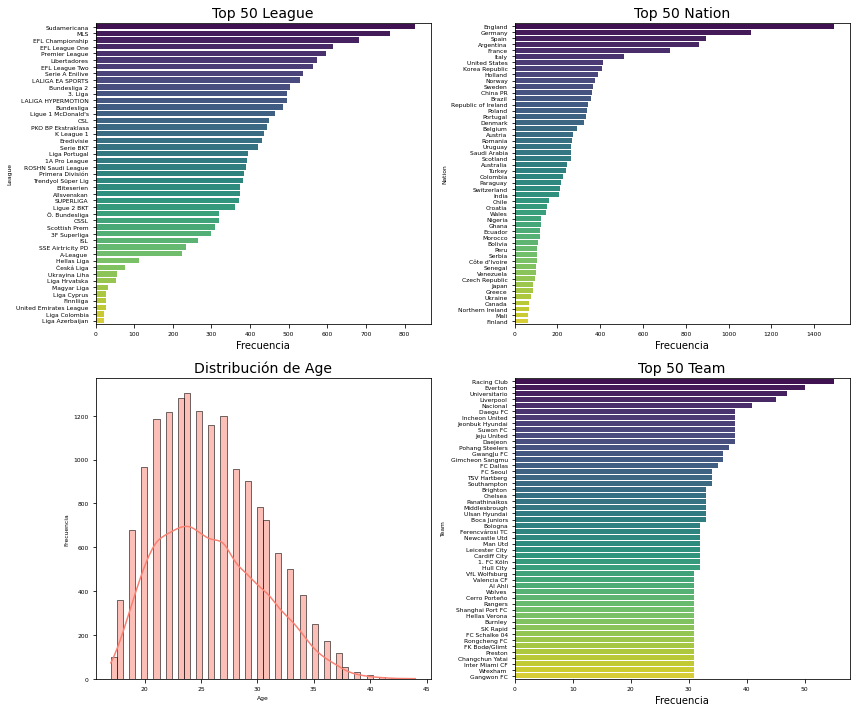

In [21]:
# Variables a graficar
cols1 = ["League", "Nation", "Age", "Team", ]

# Graficas: top 50 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols1, top_n=50, orientation="h", fontsize_ticks=6)

Grupo 1: Datos Demográficos y Contextuales (cols 1).

Este primer grupo de variables (League, Nation, Age, Team) nos da el contexto general sobre la población de jugadores.
* League y Nation: Se observa una predominancia de jugadores de las ligas y nacionalidades europeas más importantes (por ejemplo, Inglaterra, España, Alemania). Las ligas inglesas (desde la Premier League hasta la League Two) tienen una representación particularmente alta, lo que sugiere una mayor cobertura de datos de este país.

* Age: La distribución de la edad muestra un pico claro alrededor de los 24-25 años, con una forma que se asemeja a una distribución normal ligeramente sesgada a la derecha. Esto es consistente con la realidad del deporte, donde la mayoría de los jugadores alcanzan su plenitud física en la mitad de sus veintes, y un número menor continúa su carrera profesional más allá de los 30 años.

* Team: De manera similar a las ligas, existe una gran cantidad de equipos, pero pocos concentran a los jugadores de élite.

El dataset está bien representado en términos de edad, pero tiene un sesgo geográfico hacia Europa, lo cual es esperable en un dataset de fútbol de alto nivel.

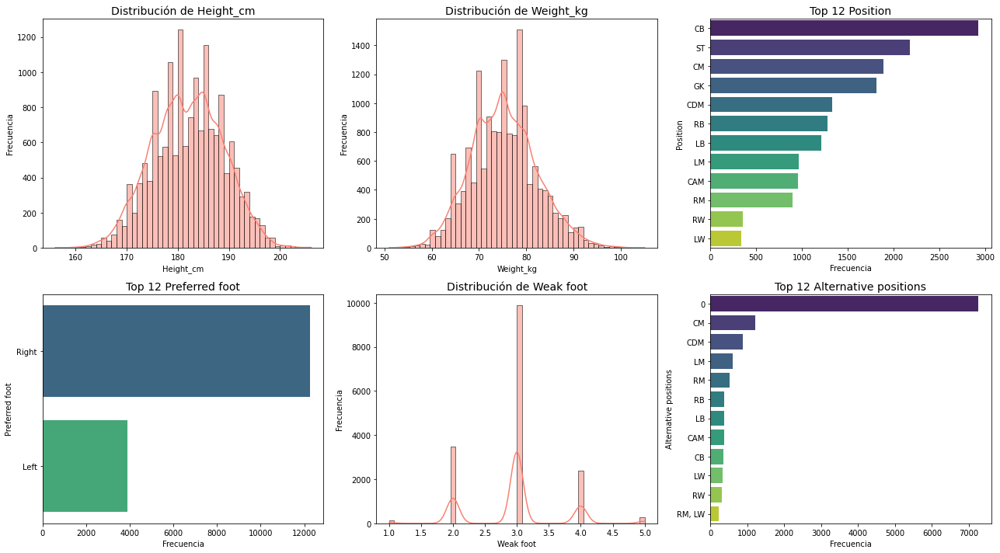

In [22]:
# Variables a graficar
cols2 = ["Height_cm", "Weight_kg", "Position", "Preferred foot", 'Weak foot', 'Alternative positions']

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols2, top_n=12, orientation="h", fontsize_ticks=10)

Grupo 2: Atributos Físicos y Posicionales (cols2):

Este grupo (Height_cm, Weight_kg, Position, etc.) nos ayuda a entender las características físicas y de rol.
* Height_cm y Weight_kg: Ambas variables siguen una distribución aproximadamente normal. La altura promedio se sitúa alrededor de 180 cm y el peso en 75 kg. Se podrían observar ligeras multimodalidades si se segmentara por posición (ej. arqueros y defensores centrales suelen ser más altos).
* Position: El análisis de frecuencia confirma que las posiciones más comunes son Defensor Central (CB), Delantero Centro (ST) y Mediocampista Central (CM), lo cual es lógico dado que son la columna vertebral de la mayoría de las formaciones.
* Preferred foot y Weak foot: Se observa una clara dominancia de jugadores diestros (Right). La habilidad del pie débil (Weak foot) tiene su moda en 3 estrellas, indicando que un jugador promedio tiene un nivel funcional, pero no excepcional, con su pie no dominante.


Los atributos físicos son coherentes con los de atletas profesionales. La distribución de posiciones y pies preferidos refleja la composición estándar de los equipos de fútbol.

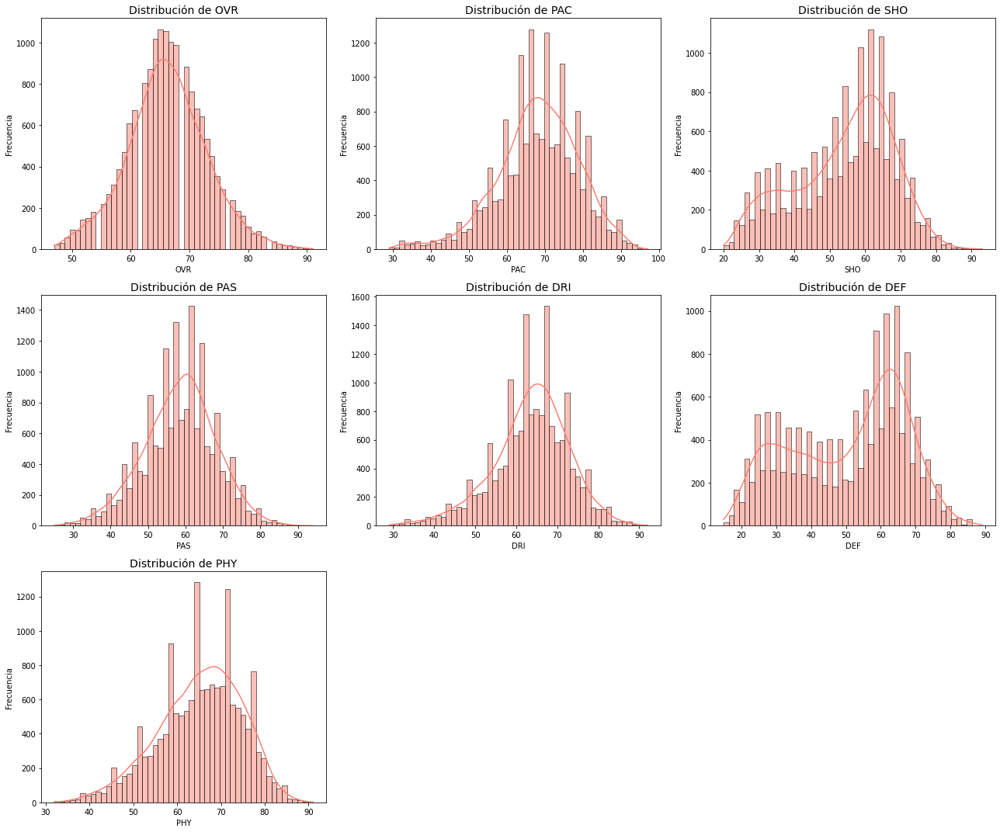

In [23]:
# Variables a graficar
cols3 = ["OVR", "PAC", "SHO", "PAS", "DRI", "DEF", "PHY"]

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols3, top_n=10, orientation="h", fontsize_ticks=10)

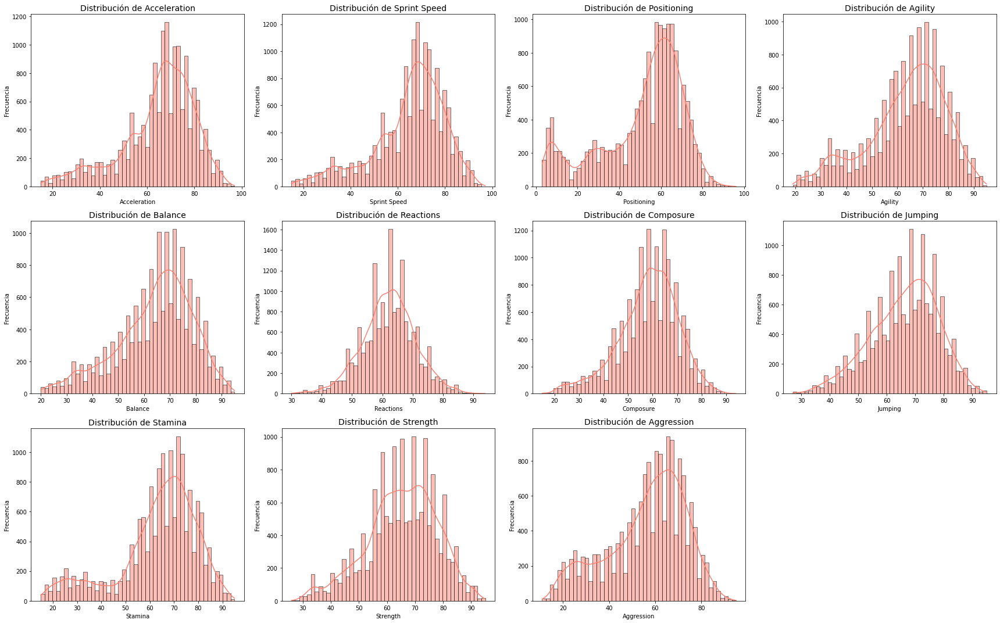

In [24]:
# Variables a graficar
cols4 = ["Acceleration", "Sprint Speed", "Positioning", 'Agility', 'Balance', 'Reactions', 'Composure',
         'Jumping', 'Stamina', 'Strength', 'Aggression']

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols4, top_n=10, orientation="h", fontsize_ticks=10)

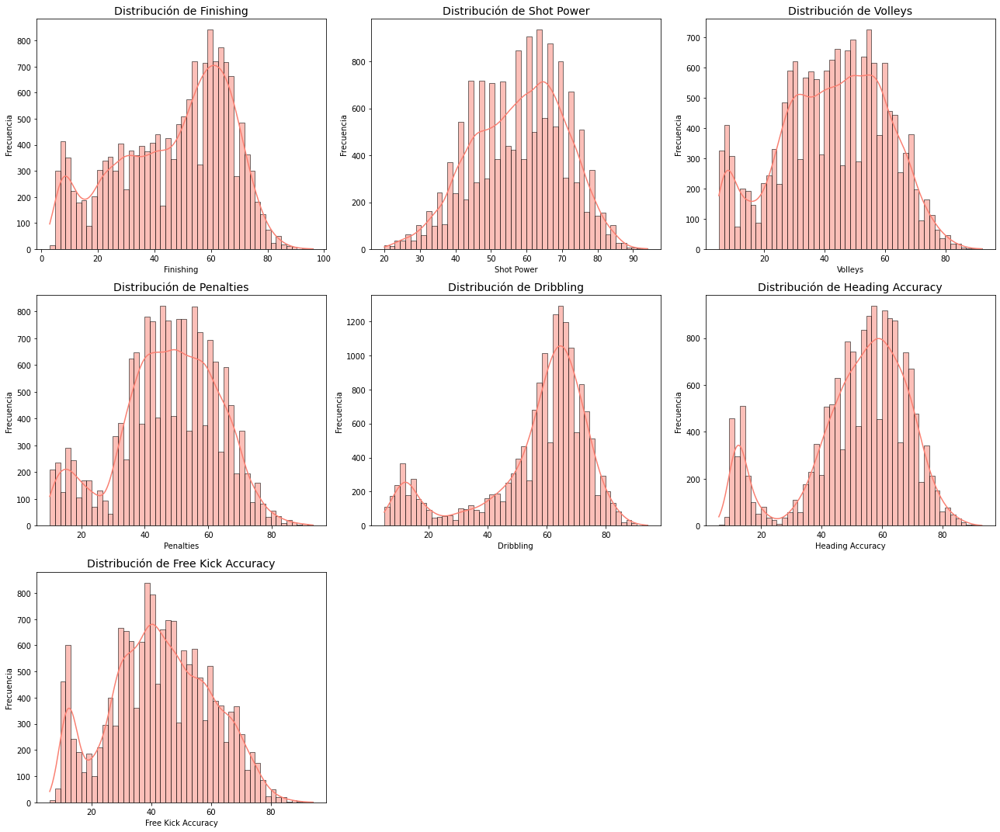

In [25]:
# Variables a graficar
cols5 = ['Finishing', 'Shot Power', 'Volleys', 'Penalties', 'Dribbling',
         'Heading Accuracy', 'Free Kick Accuracy']

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols5, top_n=10, orientation="h", fontsize_ticks=10)

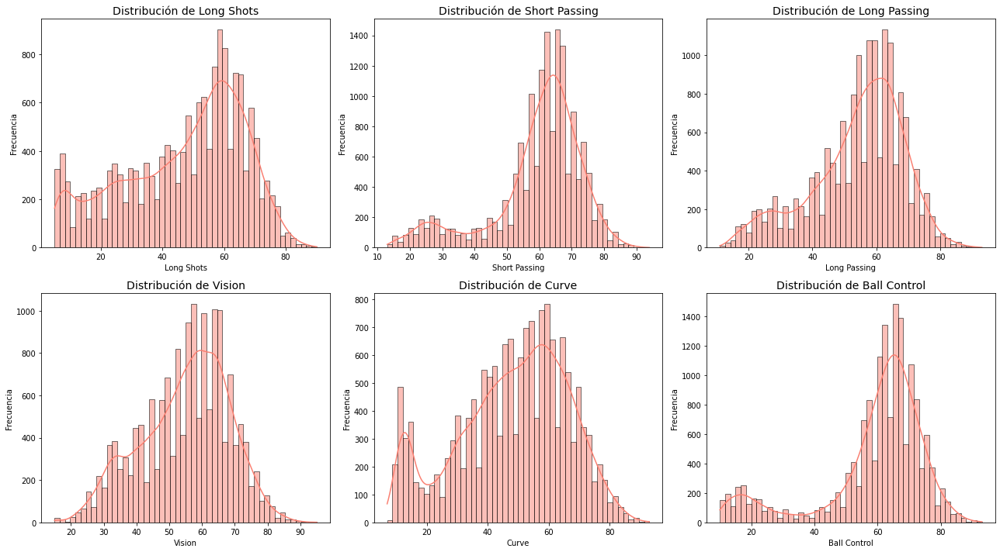

In [26]:
# Variables a graficar
cols6 = ['Long Shots', 'Short Passing', 'Long Passing', 'Vision', 'Curve', 'Ball Control']

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols6, top_n=10, orientation="h", fontsize_ticks=10)

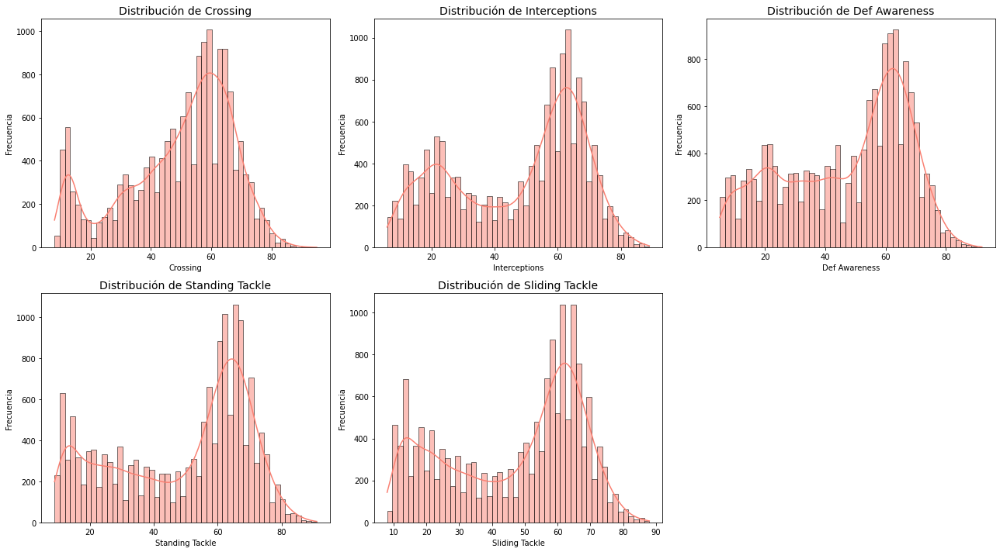

In [27]:
# Variables a graficar
cols7 = ['Crossing', 'Interceptions', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle']

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df3, cols7, top_n=10, orientation="h", fontsize_ticks=10)

Grupo 3 al 7: Atributos de Habilidad (Generales y Específicos)

Estos grupos son el núcleo del análisis, ya que representan las habilidades de los jugadores. 

* Atributos Generales (cols3 - OVR, PAC, SHO, etc.):

OVR (Overall) sigue una distribución normal, indicando que la mayoría de los jugadores son de "calidad media".
Atributos como SHO (Tiro) y DEF (Defensa) muestran distribuciones bimodales o fuertemente sesgadas. Por ejemplo, SHO tiene un grupo de jugadores con valores altos (delanteros) y una gran masa de jugadores con valores bajos (defensores, arqueros). Lo contrario ocurre con DEF. PAS (Pase) y DRI (Regate) son más centrales, característicos de los mediocampistas.

* Atributos Ofensivos Específicos (cols5, cols6):

Variables como Finishing (Finalización), Long Shots (Tiros Lejanos) y Volleys (Voleas) están muy sesgadas, con la mayoría de los jugadores teniendo valores bajos, y solo los especialistas (delanteros) destacando.
En cambio, Short Passing (Pase Corto) y Ball Control (Control de Balón) tienen distribuciones más centradas y con medias más altas, ya que son habilidades fundamentales para casi todos los jugadores de campo.

* Atributos Defensivos Específicos (cols7):

Standing Tackle, Sliding Tackle, e Interceptions muestran distribuciones casi inversas a las ofensivas. La gran mayoría de los jugadores no defensores tienen valores muy bajos, mientras que un grupo más pequeño (los defensores) concentra los valores altos.



El análisis de las distribuciones de habilidades revela patrones de especialización muy marcados. Los jugadores no son un grupo homogéneo; se dividen naturalmente en perfiles ofensivos, defensivos y balanceados. Esta estructura inherente en los datos es un excelente augurio para el éxito de los algoritmos de clustering, cuyo propósito es, precisamente, encontrar estas agrupaciones de forma automática.

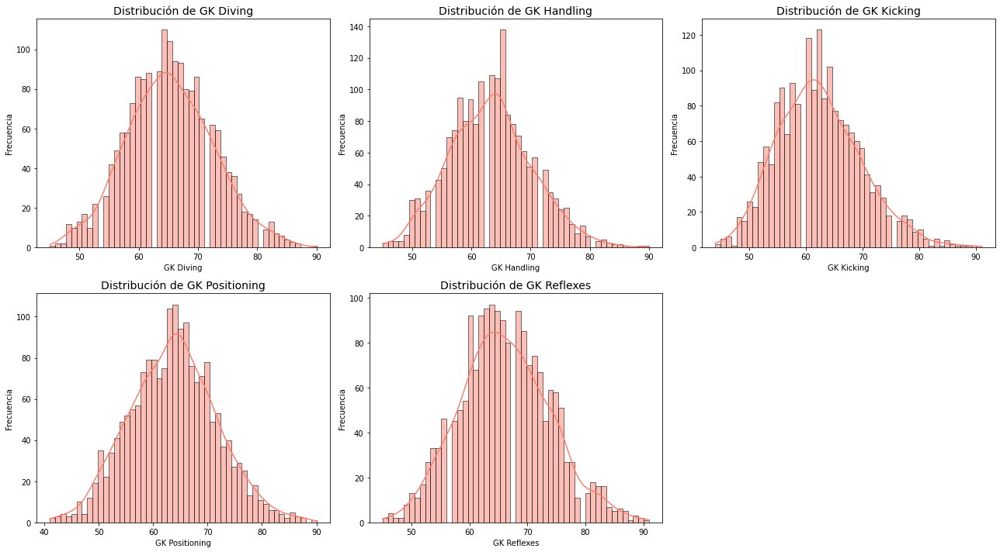

In [28]:
# Variables a graficar
# En este caso, graficamos sólo los valores no nulos
cols8 = ['GK Diving', 'GK Handling', 'GK Kicking', 'GK Positioning', 'GK Reflexes']
df_filtered = df3[(df3[cols8] != 0).all(axis=1)].copy()

# Graficas: top 20 categorías, barras horizontales, etiquetas pequeñas
plot_multiplot(df_filtered, cols8, top_n=10, orientation="h", fontsize_ticks=10)

Grupo 8: Atributos de Arquero (cols8):

Este grupo es el más especializado de todos.
* GK Diving, GK Handling, etc.: Cuando se analizan únicamente los jugadores que son arqueros (filtrando los valores nulos o ceros), estas variables muestran distribuciones relativamente normales y centradas en valores altos (ej. 60-70). Esto confirma que los arqueros son una "clase" de jugador completamente distinta, con un conjunto de habilidades que no se solapa con el de los jugadores de campo.

El análisis exploratorio ha sido fundamental para confirmar que el dataset posee una estructura clara y lógica, donde las habilidades de los jugadores se agrupan de forma natural según su rol en el campo. Hemos identificado tres perfiles principales (ofensivo, defensivo, mediocampista) y un cuarto perfil completamente distinto (arquero). Esta segmentación natural valida la estrategia de utilizar algoritmos de clustering 
para formalizar e identificar estos grupos de jugadores "intercambiables".

En lo que sigue, analizaremos los jugadores por posición, usando las variables `Overall` y `Position`.

In [29]:
# === Construir dataset: mejor jugador por posición según OVR ===
players_per_position = df3.iloc[df3.groupby(df3['Position'])['OVR'].idxmax()][['Position','Name','OVR']]

# Ordenar por OVR de mayor a menor
players_per_position = players_per_position.sort_values("OVR", ascending=False)

# Controlemos el dataset
print(players_per_position)

   Position                  Name  OVR
1       CDM                 Rodri   91
0        ST         Kylian Mbappé   91
5        CM       Kevin De Bruyne   90
3       CAM       Jude Bellingham   90
4        LW              Vini Jr.   90
12       CB       Virgil van Dijk   89
14       RW         Mohamed Salah   89
8        GK  Gianluigi Donnarumma   89
32       LB        Theo Hernández   87
51       LM              Grimaldo   86
54       RB              Carvajal   86
76       RM          Riyad Mahrez   85


Ahora, analizaremos los jugadores por naciones, usando las variables `Overall` y `Nation`.

In [30]:
# === Construir dataset: mejor promedio por jugador por nacion según OVR ===
nation_avg_overall=df3.groupby("Nation")["OVR"].mean().reset_index().sort_values("OVR",ascending=False)

# Controlemos el dataset
print(nation_avg_overall.head(10))

             Nation        OVR
42            Egypt  76.833333
99       Mozambique  75.666667
85            Libya  72.666667
17           Brazil  71.182073
37   Czech Republic  71.032258
1           Algeria  70.586207
53          Georgia  70.500000
113        Portugal  70.425150
128           Spain  70.045913
70             Iran  70.000000


### 1.2. Análisis según posición

Para analizar el `dataset` según las posiciones, primero debemos agrupar las posiciones específicas en posiciones generales.

In [31]:
# === Defino listas de posiciones por rol general ===
forwards =    ['ST', 'LW', 'RM', 'LM','RW']
midfielders = ['CAM','CDM', 'CM']
defenders =   ['CB','LB','RB']
goalkeepers = ['GK']

# === Función que asigna cada posición específica a una categoría general ===
def GeneralPosition(position):
    # Caso para forwards
    if position in forwards:
        return 'Forward'
    # Caso para midfielders
    elif position in midfielders:
        return 'Midfielder'
    # Caso para defenders
    elif position in defenders:
        return 'Defender'
    # Caso para goalkeepers
    elif position in goalkeepers:
        return 'GK'
    # Otro caso
    else:
        return 'nan'

# === Creo una nueva columna con las posiciones generales ===
df3["General_Position"] = df3["Position"].apply(lambda x: GeneralPosition(x))

# === Reviso la cantidad de jugadores por rol general ===
print(df3["General_Position"].value_counts())

General_Position
Defender      5419
Forward       4745
Midfielder    4181
GK            1816
Name: count, dtype: int64


Luego de analizar las distribuciones individuales, el siguiente paso es explorar las relaciones entre variables, segmentando por la General_Position que creamos previamente. Utilizaremos pairplots para visualizar cómo los diferentes roles (Defensor, Mediocampista, Delantero, Arquero) se posicionan en el espacio de características. 

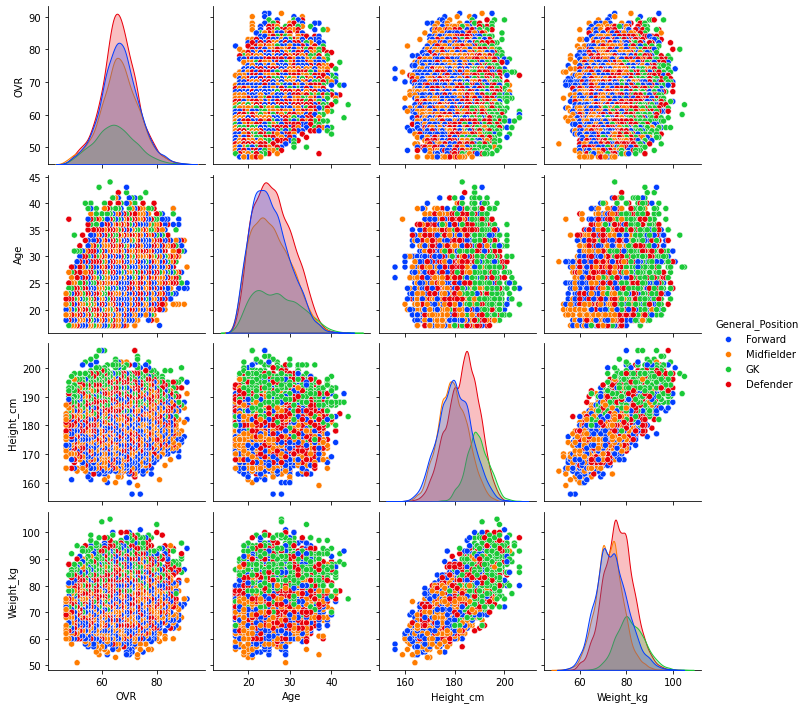

In [32]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Age", "Height_cm", "Weight_kg"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

El análisis de los atributos físicos revela una clara especialización por posición. Los arqueros y defensores centrales se distinguen por su mayor estatura y peso, características cruciales para sus roles. Los jugadores de campo muestran una relación parabólica entre la edad y su valoración general (OVR), alcanzando su pico de rendimiento cerca de los 28 años. Estas diferencias físicas son el primer indicio de la existencia de perfiles de jugador bien definidos

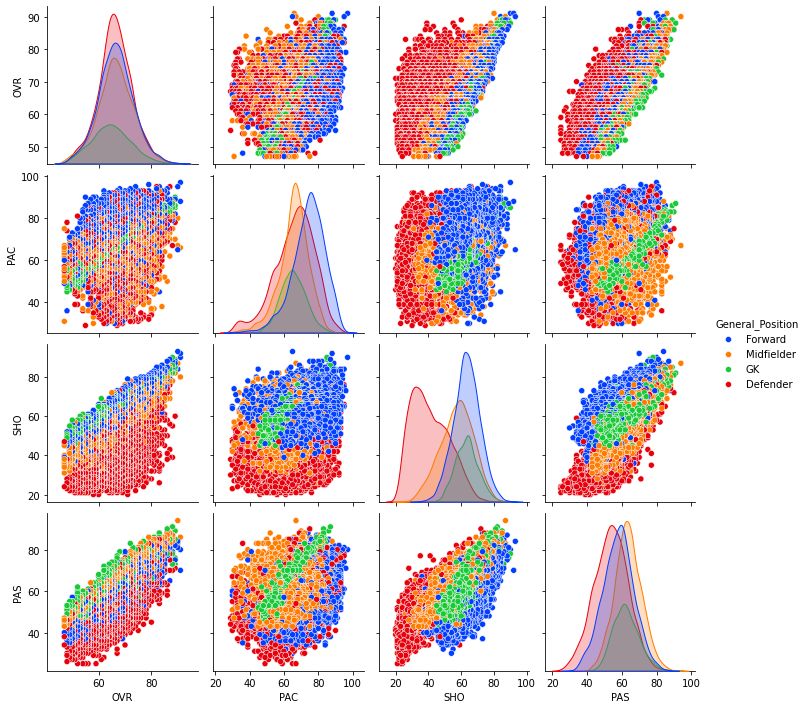

In [33]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "PAC", "SHO", "PAS"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

Este pairplot demuestra de forma contundente la especialización funcional de los jugadores. Se observa una segregación natural y clara de los cuatro roles generales: los delanteros destacan en ritmo y tiro, los mediocampistas en pase, y los defensores en atributos que no están en este gráfico (pero se ven por su bajo puntaje en tiro). Los arqueros forman un grupo aislado.

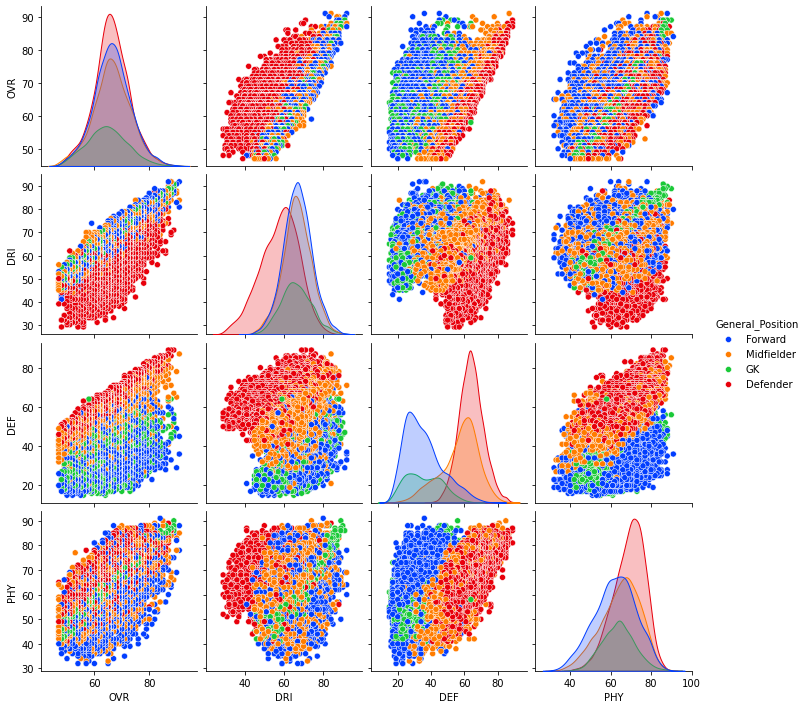

In [34]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR",  "DRI", "DEF", "PHY"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

Se confirma la dicotomía entre jugadores ofensivos y defensivos. El gráfico DEF vs DRI muestra una relación de 'trade-off': los jugadores con alta capacidad de regate (DRI) suelen tener baja capacidad defensiva (DEF) y viceversa. Los mediocampistas se sitúan en una zona intermedia, demostrando su rol como conector entre la defensa y el ataque.

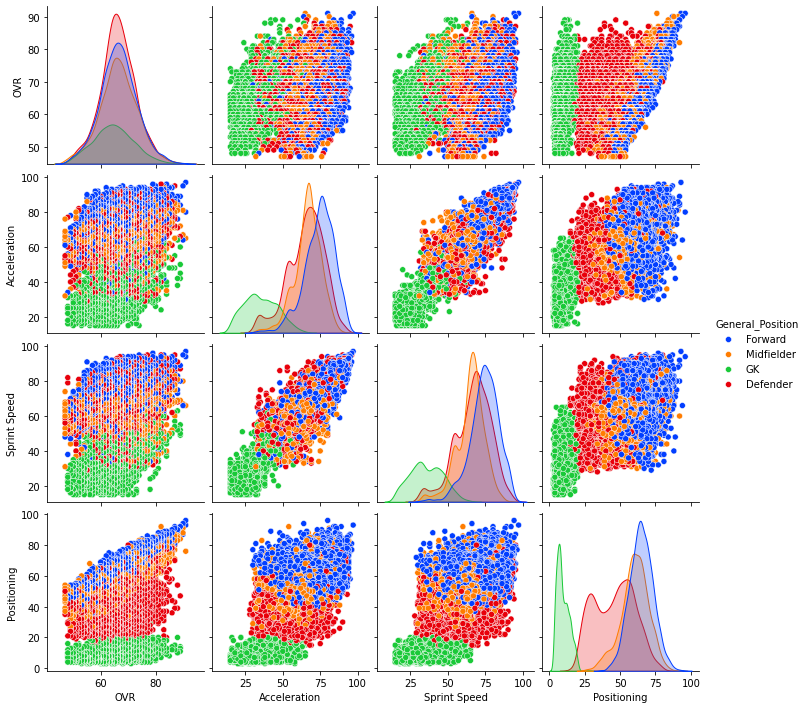

In [35]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Acceleration", "Sprint Speed", "Positioning"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

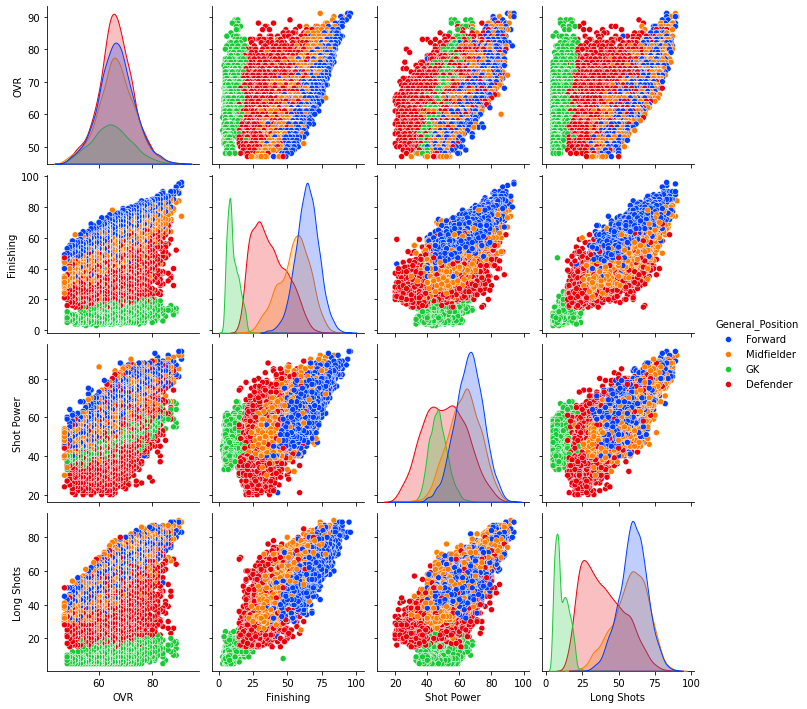

In [36]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Finishing", "Shot Power", "Long Shots"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

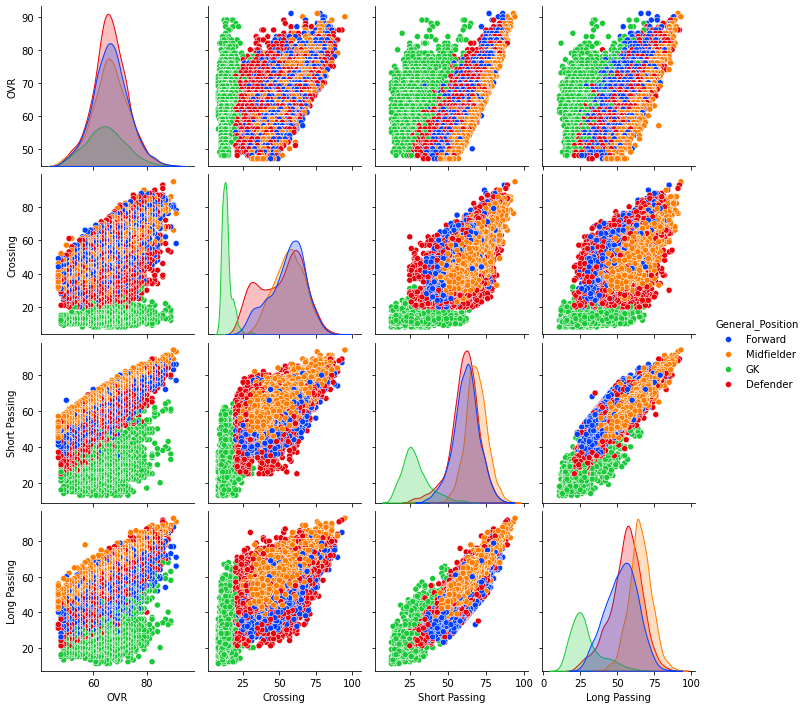

In [37]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Crossing", "Short Passing", "Long Passing"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

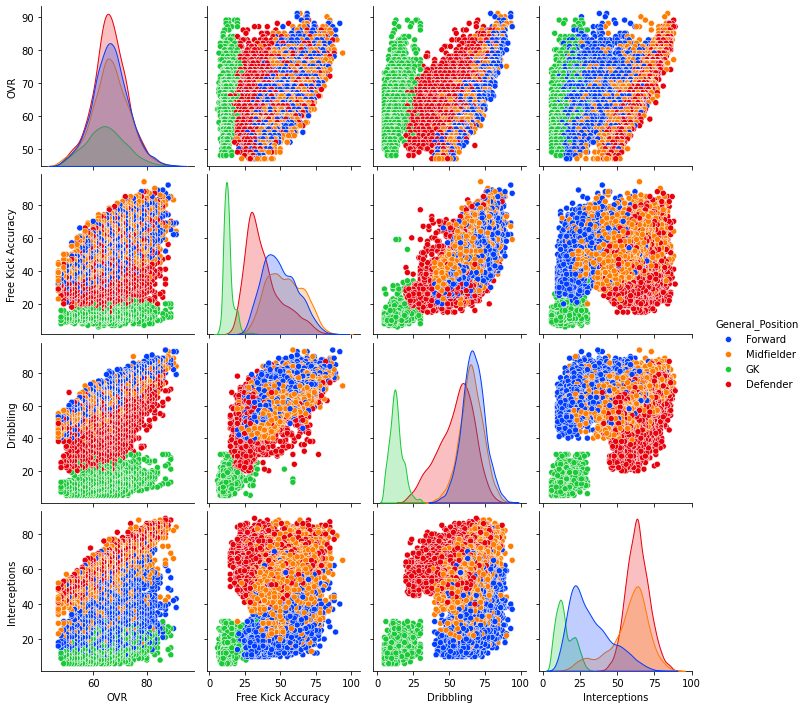

In [38]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Free Kick Accuracy", "Dribbling", "Interceptions"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

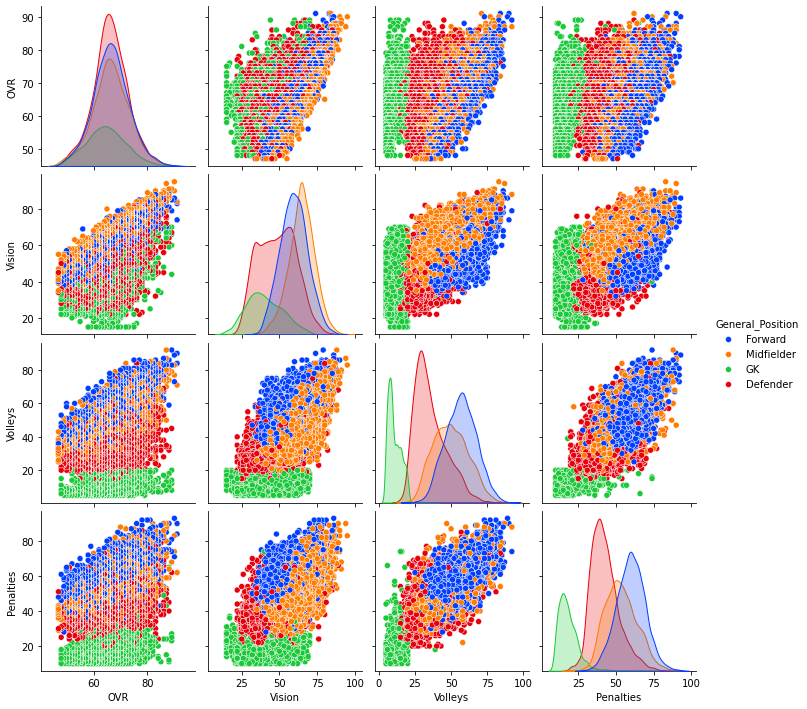

In [39]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Vision", "Volleys", "Penalties"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

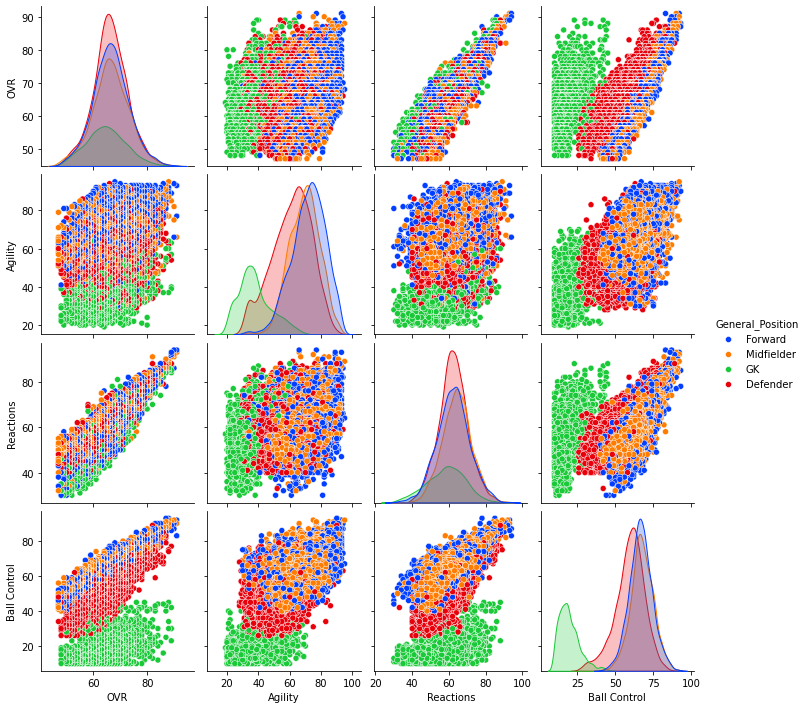

In [40]:
# === Selecciono solo algunas columnas relevantes para el análisis ===
# Incluyo la nueva columna "General_Position"
data_temp = df3.loc[:, ["General_Position", "OVR", "Agility", "Reactions", "Ball Control"]]

# === Visualizo relaciones entre variables con pairplot de Seaborn ===
# Uso "General Position" como hue para diferenciar colores por rol
sns.pairplot(data_temp, hue="General_Position", palette="bright")

Al profundizar en las habilidades específicas, los perfiles de jugador se vuelven aún más evidentes.

Perfil Ofensivo: Se define por la alta correlación entre Finishing, Shot Power y Positioning, atributos claramente dominados por los delanteros.
Perfil de Creador de Juego: Caracterizado por altos valores en Vision, Long Passing y Short Passing, es el sello distintivo de los mediocampistas.
Perfil Técnico: Habilidades como Ball Control y Dribbling son altas tanto en mediocampistas ofensivos como en delanteros, diferenciando a los jugadores de ataque más técnicos.

En conjunto, estos análisis confirman que las variables de habilidad no están distribuidas al azar, sino que siguen patrones estructurales que definen arquetipos de jugadores. Esta evidencia es crucial y nos da una gran confianza para proceder con el modelado de clustering.

### 2. Exploración Visual de a Pares de Variables para Clustering

Hemos realizado un análisis general de las variables. A partir de lo observado, estudiaremos de a dos variables con mayor detalle. La selección de varialbes se hace con el objetivo de responder a la pregunta '¿Puedo crear clusters que me indiquen similaridad entre jugadores por funcionalidad, para pensar cambios?'. En el caso de los atributos asociados a arqueros, los descartamos a partir de las observaciones del punto anterior: Muchos atributos agrupan a los arqueros alrededor de los valores más bajos.

In [41]:
# Veamos ahora algunas variables de desempeño por habilidad de los jugadores
skills_ratings = ['Acceleration', 'Sprint Speed', 'Positioning', 'Finishing', 'Shot Power',
                  'Long Shots', 'Volleys', 'Penalties', 'Vision', 'Crossing', 'Short Passing', 'Long Passing',
                  'Dribbling', 'Agility', 'Balance', 'Reactions', 'Ball Control', 'Interceptions',
                  'Heading Accuracy', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle', 
                  'Strength', 'Aggression']

# Controlemos el número de variables 
print('Hay', len(skills_ratings), 'variables numéricas de desempeño según habilidad')

Hay 24 variables numéricas de desempeño según habilidad


Contruimos un dataeset con estas habilidades

In [42]:
# Dataset sólo con desempeños según habilidad (que sean variables numéricas)
df_skills=df3[skills_ratings]

In [43]:
# Veamos las primeras columnas
df_skills.head(10)

,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Short Passing,Long Passing,Dribbling,Agility,Balance,Reactions,Ball Control,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Strength,Aggression
0,97,97,93,94,90,83,84,84,83,78,86,71,93,93,82,93,92,38,73,26,34,32,77,64
1,65,66,76,74,92,89,71,62,84,76,93,91,84,66,67,93,90,84,81,92,87,82,83,85
2,80,94,96,96,94,83,90,90,74,58,77,66,79,77,69,94,83,43,83,38,47,29,93,88
3,81,80,91,90,85,86,77,74,90,66,89,89,89,82,79,91,89,82,75,77,79,77,77,85
4,95,95,87,89,81,83,73,71,85,81,83,77,93,94,84,86,90,26,50,32,25,18,65,58
5,67,67,88,84,92,90,83,83,95,95,94,93,86,75,78,92,92,66,55,66,70,53,75,75
6,64,66,94,95,94,89,89,93,86,80,86,88,82,66,73,94,87,42,91,46,46,38,86,80
7,72,69,84,83,82,84,79,68,91,86,91,89,89,85,83,91,91,69,55,68,72,57,56,64
8,50,55,14,12,55,18,8,24,60,12,36,34,28,57,38,84,30,26,12,21,14,16,75,30
9,60,49,13,13,64,14,20,23,66,17,60,58,27,40,37,87,42,11,29,15,19,16,78,27


In [44]:
# Y tambien veamos las últimas columnas
df_skills.tail(10)

,Acceleration,Sprint Speed,Positioning,Finishing,Shot Power,Long Shots,Volleys,Penalties,Vision,Crossing,Short Passing,Long Passing,Dribbling,Agility,Balance,Reactions,Ball Control,Interceptions,Heading Accuracy,Def Awareness,Standing Tackle,Sliding Tackle,Strength,Aggression
16151,62,60,52,32,52,33,31,42,43,36,50,46,45,71,76,50,48,42,46,38,38,44,33,51
16152,49,50,44,32,44,38,33,42,43,31,54,50,46,52,66,48,44,37,46,32,40,43,37,56
16153,61,60,46,40,40,32,36,42,40,44,43,31,53,63,71,38,46,16,26,21,21,20,40,35
16154,68,62,46,30,49,32,30,42,42,32,51,50,42,51,63,53,49,36,45,32,36,43,58,55
16155,53,56,35,21,24,28,25,30,34,35,34,31,38,52,54,44,34,49,37,46,48,45,70,63
16156,32,31,39,44,48,50,25,43,55,38,45,51,51,64,68,32,50,23,37,33,39,40,36,47
16157,66,67,47,34,50,33,32,40,43,35,54,56,41,59,71,46,42,37,47,36,41,47,53,59
16158,55,59,50,47,44,50,32,51,45,38,37,33,49,60,66,48,48,41,50,43,42,42,57,24
16159,69,63,45,24,52,39,33,42,41,39,52,55,45,54,59,46,43,42,49,34,42,49,68,54
16160,51,60,37,31,40,32,26,41,35,35,51,50,43,57,60,45,42,43,42,40,45,51,57,56


***Visualización general***

Para tener una idea general, a pesar de la poca resolución que pueda tener, realizaremos una gráfica de todos las habilidades seleccionadas. Aqui, el objetivo es identificar pares de habilidades que puedan presentar algún comportamiento de interés.  

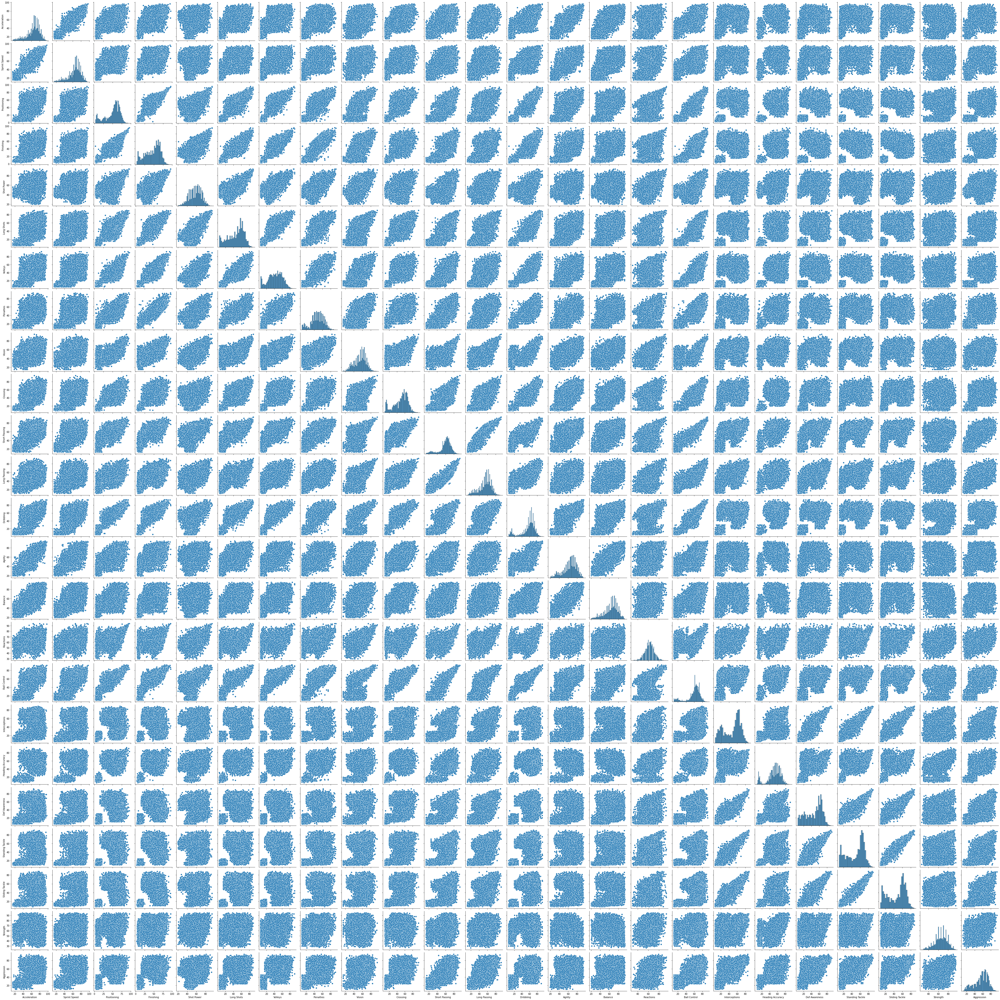

In [45]:
# Grafiquemos en un plot general las variables para tener una idea general
sns.pairplot(df_skills[skills_ratings])

A simple vista, podemos ver que con algunos pares de variables parece poder formarse al menos dos clusters. Vamos a seleccionar las variables que, a simple vista, parecen reflejar mejor este comportamiento. Veamos una visualización a mayor escala de estas:

['Positioning', 'Finishing', 'Long Shots', 'Volleys', 'Penalties', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle']


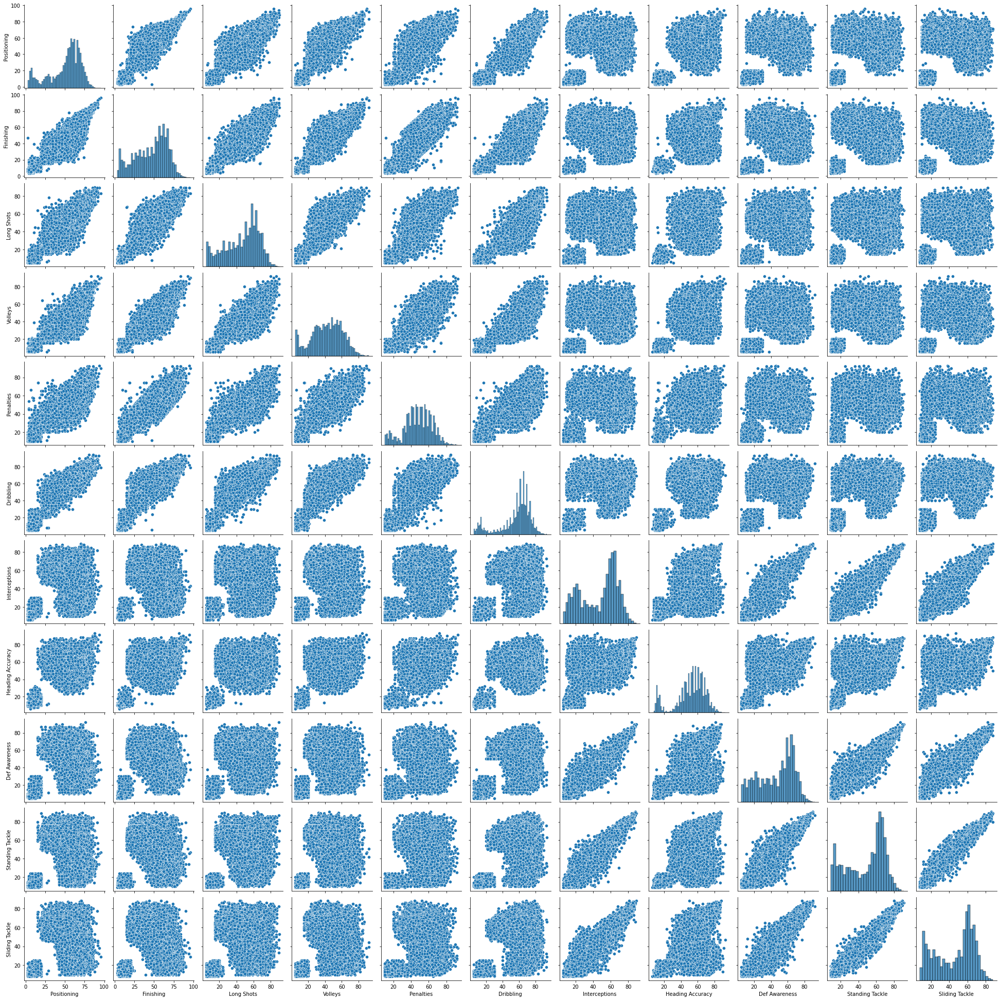

In [46]:
# Seleccionaremos algunas de estas columnas de skills_ratings para graficarlas
cols = ['Positioning', 'Finishing', 'Long Shots', 'Volleys', 'Penalties', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle']
print(cols)

# Pairplot con esas columnas
sns.pairplot(df_skills[cols])

***Visualización particular dos a dos***

A partir del panorama general, podemos identificar pares de habilidades de interés. Además, podemos comprar los resultados considerando:

- Jugador ideal
- Jugador promedio

Crearemos el jugador perfecto para ver a donde se ubica en nuestra visualización. Notar que sólo consideraremos las variables preseleccionadas al inicio de esta sección.

In [47]:
#Generamos un diccionario con el jugador con puntaje perfecto en OVR 
PerfectPlayerDict = {'Name':'MachineGun','OVR':99}

# Controlamos para cada columna
for skills in skills_ratings:
    PerfectPlayerDict[skills] = 99

# Introducimos esta columna dentro del dataset 
df4 = pd.concat([df3, pd.DataFrame([PerfectPlayerDict])], ignore_index=True)

Luego, crearemos el jugador promedio con el objeto de ver a donde se ubica en nuestra visualización.

In [48]:
#Generamos un diccionario con el jugador con puntaje promedio en OVR 
MeanPlayerDict = {'Name':'JugadorPromedio','OVR':df.OVR.mean()}

# Controlamos para cada columna
for skills in skills_ratings:
    MeanPlayerDict[skills] = df3[skills].mean()

# Introducimos esta columna dentro del dataset 
df4 = pd.concat([df4, pd.DataFrame([MeanPlayerDict])], ignore_index=True)

Ahora veamos las habilidades elegidas, comparándolas dos a dos.

In [49]:
# Definimos las variables seleccionadas (skills FIFA)
skills = ['Positioning', 'Finishing', 'Long Shots', 'Volleys', 'Penalties', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle']

# Definimos condiciones para clasificar jugadores
Jugador_elegido = df["Name"] == "Kylian Mbappé"   # Elegimos un jugador específico (Mbappé en este caso)
bool_crack = df["OVR"] > 85                       # "Crack" = jugadores con Overall alto
bool_no_crack = df["OVR"] <= 85                   # Jugadores promedio
bool_elecc = df["Position"] == "CB"               # Ejemplo: Defensores centrales
bool_machinegun = df["Name"] == "MachineGun"      # Jugador inventado

# Definimos una paleta de colores para diferenciar categorías
palette = ["#1f77b4",  # azul
           "#ff7f0e",  # naranja
           "#2ca02c",  # verde
           "#d62728",  # rojo
           "#9467bd",  # violeta
           "#8c564b"]  # marrón

A continuación defino una función capaz de crear el gráfico dos a dos.

In [50]:
# =============================
# Función que genera el gráfico
# =============================
def plot_skills(skill_1, skill_2):
    """
    Genera un gráfico comparando dos habilidades (skill_1 vs skill_2)
    para diferentes grupos de jugadores.
    """
    
    # ---- Grupo: Jugadores Crack ----
    n_crack = go.Scatter(
        x=df.loc[bool_crack, skill_1], 
        y=df.loc[bool_crack, skill_2],
        name="Crack",
        text=df.loc[bool_crack, "Name"],   # mostramos nombres al pasar el mouse
        textfont=dict(family="sans serif", size=12, color="black"),
        opacity=0.9,
        marker=dict(color=palette[2], size=7),
        mode="markers"
    )

    # ---- Grupo: Jugadores promedio ----
    n_no_crack = go.Scatter(
        x=df.loc[bool_no_crack, skill_1], 
        y=df.loc[bool_no_crack, skill_2],
        name="Jugador Promedio",
        text=df.loc[bool_no_crack, "Name"],
        opacity=0.5,
        marker=dict(color=palette[0], size=4),
        mode="markers"
    )

    # ---- Grupo: Defensores (ejemplo CB) ----
    n_elecc = go.Scatter(
        x=df.loc[bool_elecc, skill_1], 
        y=df.loc[bool_elecc, skill_2],
        name="Defensores (CB)",
        text=df.loc[bool_elecc, "Position"],
        opacity=0.8,
        marker=dict(color=palette[1], size=6, symbol="triangle-up"),
        mode="markers"
    )

    # ---- Jugador inventado (MachineGun) ----
    n_machinegun = go.Scatter(
        x=df.loc[bool_machinegun, skill_1], 
        y=df.loc[bool_machinegun, skill_2],
        name="Jugador perfecto",
        textfont=dict(family="sans serif", size=16, color="black"),
        opacity=0.9,
        marker=dict(color=palette[3], size=25, symbol="star"),
        mode="markers+text"
    )

    # ---- Jugador elegido (ejemplo: Messi) ----
    n_Jugador_elegido = go.Scatter(
        x=df.loc[Jugador_elegido, skill_1], 
        y=df.loc[Jugador_elegido, skill_2],
        name="Jugador elegido",
        text=df.loc[Jugador_elegido, "Name"],
        textfont=dict(family="sans serif", size=18, color="black"),
        opacity=1,
        marker=dict(color=palette[4], size=35, symbol="diamond"),
        mode="markers+text"
    )

    # Juntamos todas las capas de datos
    data = [n_no_crack, n_elecc, n_crack, n_machinegun, n_Jugador_elegido]

    # Layout del gráfico
    layout = go.Layout(
        title=dict(
            text=f"Comparación de jugadores FIFA: {skill_1} vs {skill_2}",
            font=dict(size=22)   # aquí reemplazamos titlefont por font
        ),
        xaxis=dict(title=skill_1, showgrid=True),
        yaxis=dict(title=skill_2, showgrid=True),
        autosize=False,
        width=1000,
        height=650,
        legend=dict(bgcolor="white", bordercolor="black", borderwidth=1)
    )

    # Figura final y visualización
    fig = go.Figure(data=data, layout=layout)
    fig.show()

Luego, generamos la grafica interactiva

In [51]:
# ====================
# Widgets interactivos
# ====================
# Creamos dos menús desplegables para elegir las habilidades
interact(plot_skills, 
         skill_1=widgets.Dropdown(options=skills, value="Positioning", description="Skill X:"),
         skill_2=widgets.Dropdown(options=skills, value="Finishing", description="Skill Y:"))

interactive(children=(Dropdown(description='Skill X:', options=('Positioning', 'Finishing', 'Long Shots', 'Vol…

<function __main__.plot_skills(skill_1, skill_2)>

## 3. Normalización

En términos generales, el escaleado o normalización de los datos a la hora de aplicar algoritmos de clustering o embedding es necesaria para evitar que haya variables que tengan mucho más pesos que otras debido a su diferencia de escalas. En este trabajo en particular, al usar las variables seleccionadas en la [sección anterior](#2.-Exploraci%C3%B3n-Visual-de-a-Pares-de-Variables-para-Clustering) no es necesario escalar, dado que todas las variables tienen el mismo rango (0-99). Aún así, en las siguientes secciones se aplica, como buen hábito, escaleo o normalización, a fin de que nos quede un código escalable y portable, y con el que podamos, en caso de creerlo necesario, otras variables.

## 4. Clustering

La idea central es agrupar jugadores con habilidades similares de manera que los grupos encontrados puedan representar “roles” o “perfiles de juego” equivalentes. Esto permitiría, por ejemplo, sustituir un jugador lesionado por otro con un conjunto de características comparables.

1. ***Selección de variables***

Para la agrupación usamos el subconjunto de características técnicas seleccionado en la [sección 2](#2.-Exploraci%C3%B3n-Visual-de-a-Pares-de-Variables-para-Clustering): Positioning, Finishing, Long Shots, Volleys, Penalties, Dribbling, Interceptions, Heading Accuracy, Def Awareness, Standing Tackle y Sliding Tackle. Estas fueron seleccionadas al ser aquellas variables que mostraron mejor capacidad para dividir a los jugadores en al menos dos grupos, según se vió e la sección 2.

Utilizaremos dos algoritmos, *K-means* y *DBSCAN*. Para aplicar los algoritmos:
- Normalizamos las variables (StandardScaler o MinMaxScaler) para evitar que una métrica domine sobre las otras.
- Usamos distancia euclídea como medida de similitud porque es la más estándar en espacios normalizados de características continuas.

2. ***Clustering con K-means***

- Idea: agrupa jugadores en k grupos esféricos, optimizando la similitud interna.
- Hiperparámetro clave: número de clusters k. Se determina usando el método del codo (analizando la inercia) o el índice de silueta.
- Ventaja: simple, interpretable, rápido en grandes datasets.
- Desventaja: impone la idea de clusters “esféricos” y obliga a fijar k.

3. ***Clustering con DBSCAN (Density-Based Spatial Clustering of Applications with Noise)***

- Idea: agrupa jugadores que se encuentran en regiones de alta densidad y deja como outliers a jugadores con perfiles muy atípicos.
- Hiperparámetros:
    - eps: radio de vecindad. Se puede estimar con la gráfica de distancias k-NN (k-dist plot). (ver *[Ester et al.: A Density-Based Algorithm for Discovering Clusters in Large Spatial Databaseswith Noise](https://cdn.aaai.org/KDD/1996/KDD96-037.pdf)*)
    - min_samples: número mínimo de vecinos para no considerar a una muestra como outlier. Los gráficos vistos hasta ahora no muestran un dataset demasiado ruidoso, por lo que elegimos min_samples = $2 \cdot d$, donde $d$ es la dimensión del espacio (cantidad de features elegidas). (ver *Schubert et al.: DBSCAN Revisited, Revisited: Why and How You Should (Still) Use DBSCAN*)
- Ventaja: no requiere especificar número de clusters y detecta outliers (jugadores únicos con habilidades extraordinarias). Más robusto para clusters de cualquier forma.
- Desventaja: sensible a la escala de los datos y a la elección de eps.

4. ***Comparación de métodos***

- K-means: útil para obtener particiones claras de jugadores en roles definidos. Sirve para crear “grupos intercambiables” en plantillas.
- DBSCAN: revela tanto los perfiles comunes como los casos excepcionales (ejemplo: Lionel Messi o Cristiano Ronaldo).

Ambos enfoques son complementarios:

- Con K-means podemos identificar los roles principales.
- Con DBSCAN podemos encontrar talentos atípicos que no son fácilmente reemplazables.

5. ***Justificación de elección de parámetros***

- Distancia: Euclídea porque las variables son continuas y están normalizadas.
- Número de clusters en K-means: elegido mediante método del codo/silueta.
- Parámetros en DBSCAN: eps ajustado visualmente con curva k-dist y min_samples=$2 \cdot d$, con $d$ tamaño del espacio (criterio estándar para datasets con más de dos variables).

In [52]:
# ============================================
# Clustering de jugadores con K-Means y DBSCAN
# ============================================

# ==============
# Cargar dataset
# ==============

# Seleccionamos algunas columnas de habilidades técnicas de los jugadores
skills = ['Positioning', 'Finishing', 'Long Shots', 'Volleys', 'Penalties', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness', 'Standing Tackle', 'Sliding Tackle']
d = len(skills) # Dimensión del espacio

# Creamos un DataFrame reducido solo con esas variables
df_skills = df3[skills]

# =================================
# Manejo de valores faltantes (NaN)
# =================================

print(f"Valores faltantes por columnas:\n{df_skills.isnull().sum()}")

## Cuando tenemos valores faltantes, podemos seguir dos opciones: Tirar filas o imputar

# OPCIÓN A: Eliminar filas que contengan al menos un NaN
#df_skills_drop = df_skills.dropna()

# OPCIÓN B: Imputar valores faltantes con la media de cada columna
#imputer = SimpleImputer(strategy="mean")
#df_skills_imputed = pd.DataFrame(imputer.fit_transform(df_skills),
#                                 columns=df_skills.columns)

# Elegimos cuál dataset usar para clustering
# En nuestro caso optamos por usar df_skills dado que no presenta valores faltantes
X = df_skills

# =====================
# Escalado de los datos
# =====================
# Importante porque:
# Si no escalamos, las variables con valores grandes dominarían la distancia

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)  # convertimos a escala estándar (media=0, varianza=1)

Valores faltantes por columnas:
Positioning         0
Finishing           0
Long Shots          0
Volleys             0
Penalties           0
Dribbling           0
Interceptions       0
Heading Accuracy    0
Def Awareness       0
Standing Tackle     0
Sliding Tackle      0
dtype: int64


## 4.1. Clustering K-means

Para n_clusters = 2 El silhouette_score promedio es : 0.5648334229412387
Para n_clusters = 3 El silhouette_score promedio es : 0.4445738029065112
Para n_clusters = 4 El silhouette_score promedio es : 0.4025807759167264
Para n_clusters = 5 El silhouette_score promedio es : 0.3450781077218302
Para n_clusters = 6 El silhouette_score promedio es : 0.3054591109814547
Para n_clusters = 7 El silhouette_score promedio es : 0.2925165574602265


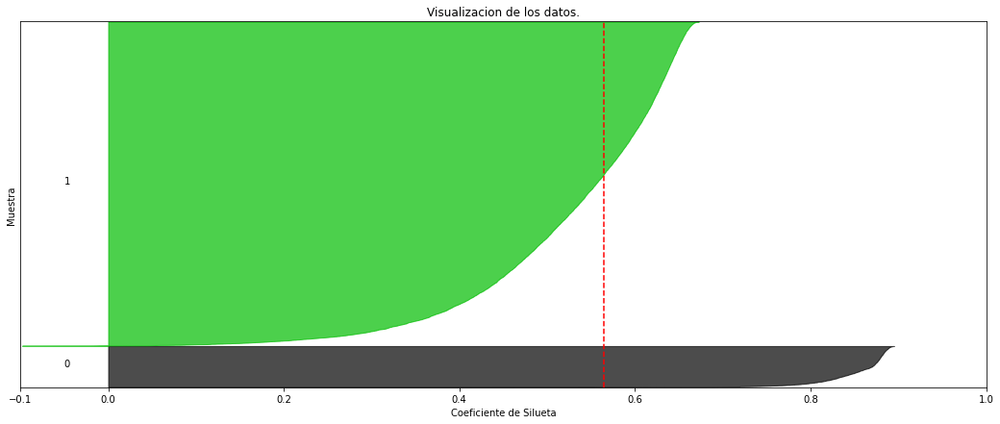

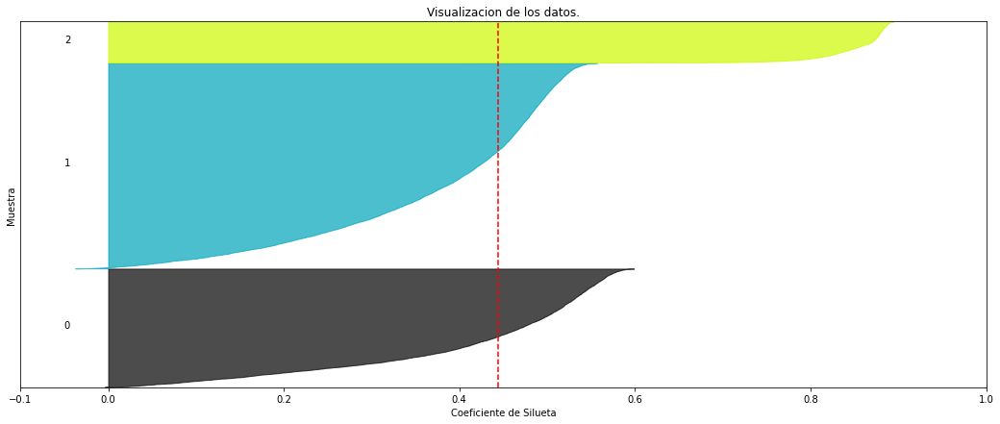

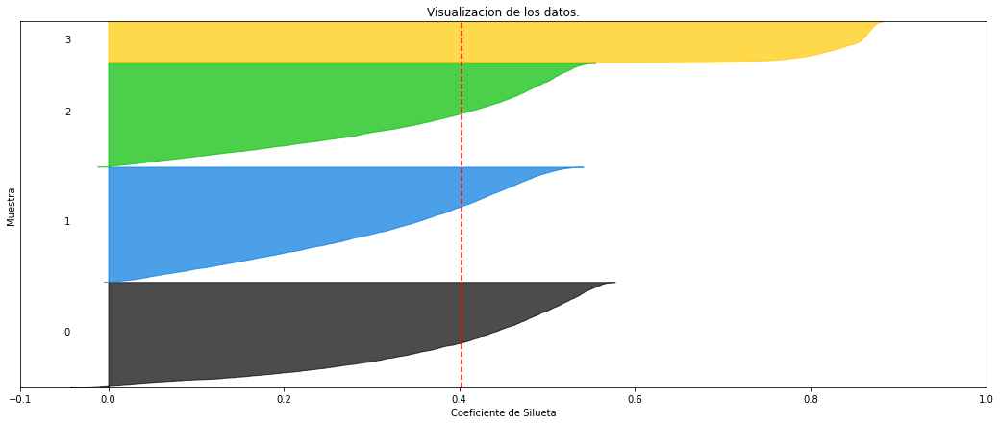

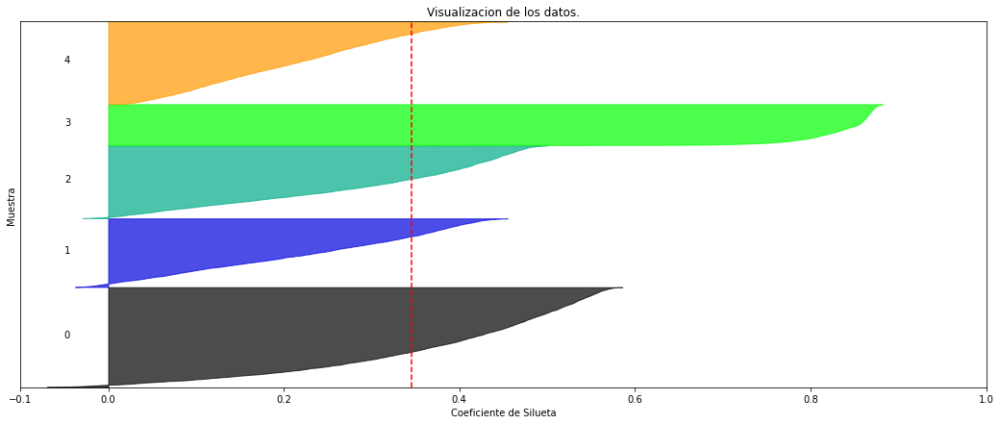

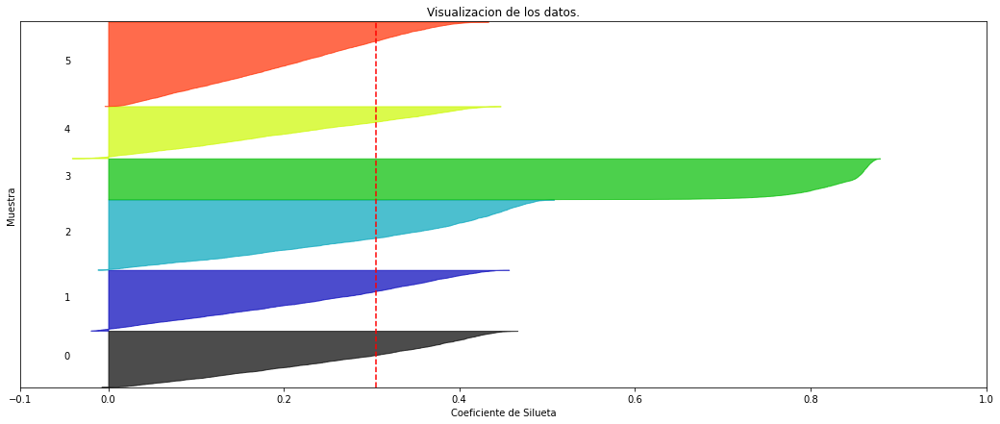

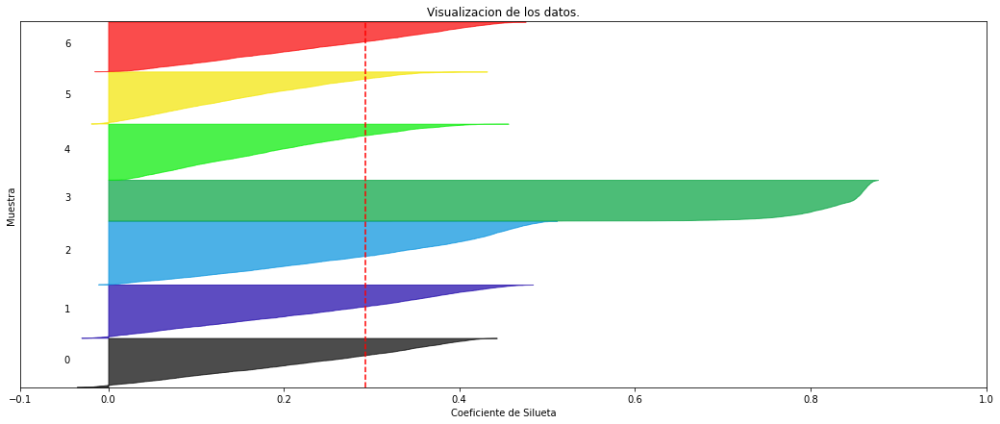

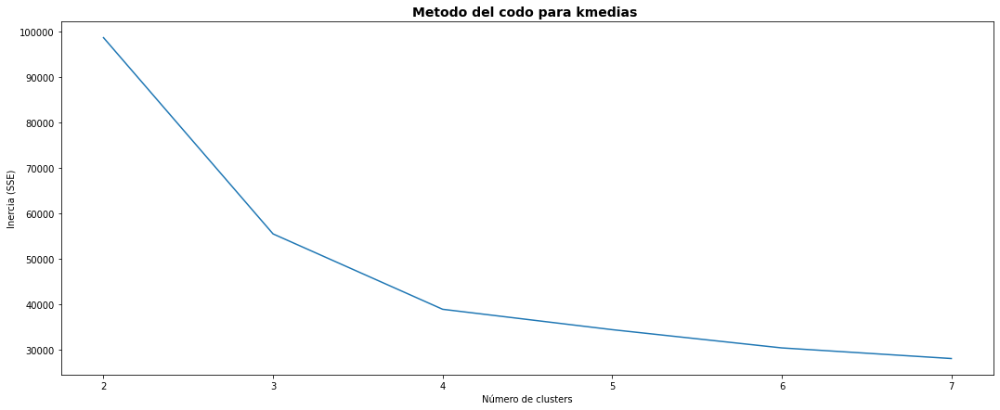

In [53]:
# ======================
# Clustering con K-Means
# ======================

# ---- Método de silueta para elegir K ----

range_n_clusters = range(2, 8)    # probamos de 2 a 7 clusters
sse ={}
for n_clusters in range_n_clusters:
    plt.figure(figsize=(18, 7))

    # Instancio el clusterer con el parámetro n_clusters. Fijo la semilla aleatoria en 10 para reproducibilidad.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X_scaled)
    sse[n_clusters] = clusterer.inertia_

    # El silhouette_score da el valer medio del coeficiente de silueta para todas las muestras
    # Da idea de la densidad y separabilidad de los clusters creados.
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    print("Para n_clusters =", n_clusters,
          "El silhouette_score promedio es :", silhouette_avg)

    # Calculamos el coeficiente de silueta para cada muestra
    sample_silhouette_values = silhouette_samples(X_scaled, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Agregamos los coeficientes de silueta para el cluster i-ésimo y los ordenamos
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Etiqueta a cada silueta con su número de cluster
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Calcula el nuevo valor de y_lower para el próximo cluster
        y_lower = y_upper + 10  # 10 for the 0 samples
        
    # La línea vertical muestra el valor medio del coeficiente de silueta para todas las muestras
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")

    plt.title("Visualizacion de los datos.")
    plt.xlabel("Coeficiente de Silueta")
    plt.ylabel("Muestra")
    plt.xlim([-0.1, 1]) # Observamos que los valores de coeficiente de silueta no llegan a ser menores a 0.1
    # El valor (n_clusters+1)*10 es para insertar un espacio e blanco entre gráficos de coeficientes de silueta
    plt.ylim([0, len(X_scaled) + (n_clusters + 1) * 10])
    plt.yticks([])  # Dejamos el eje y sin etiquetas distintas de las de los clusters
    plt.xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

plt.show()

# ---- Método del codo para elegir K ----

plt.figure(figsize=(18, 7))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Número de clusters")
plt.ylabel("Inercia (SSE)")
plt.title(("Metodo del codo para kmedias "),
                 fontsize=14, fontweight='bold')
plt.show()

Observamos que:
- Si bien K-Means con 2 clusters tiene el mayor coeficiente de silueta promedio, y su gráfico de silueta tiene 'más relleno', también tiene una inercia muy alta. Esto indica que tenemos estamos considerando clusters demasiado grandes en los que hay subclusters que pueden considerarse por separado.
- Por otro lado, K-Means con 4 clusters se presenta como el valor óptimo en el gráfico de codo, además de tener el coeficiente de silueta medio más grande (después de n_clusters = 2), de tener dientes menos pronunciados y no presentar valores negativos en los gráficos de coeficientes de silueta.

Luego, tenemos que el valor óptimo de n_clusters es 4:

In [54]:
# ======================
# Clustering con K-Means
# ======================
# ---- Entrenamos KMeans con el número óptimo de clusters ----
kmeans = KMeans(n_clusters=4, random_state=10, n_init=10) # n_init iteraciones, nos quedamos con la que tiene mejor SSE
clusters_kmeans = kmeans.fit_predict(X_scaled)

# Guardamos el resultado en el DataFrame X -no escaleado-
X["Cluster_KMeans"] = clusters_kmeans

## 4.2. DBSCAN

Iniciamos con una búsqueda heurística para determinar eps usando un gráfico de distancia k ordenada. La elección de min_samples se hizo tomando el valor estándar para espacios de más de dos dimensiones de $2 \cdot d$, con $d$ dimensión del espacio.

In [55]:
def kdist_plot(X, min_samples=10, metric='euclidean', show=True):
    """
    Calcula la curva k-dist (distancia al k-ésimo vecino).
    Devuelve las distancias ordenadas y un valor eps sugerido.
    """
    nn = NearestNeighbors(n_neighbors=min_samples, metric=metric)
    nn.fit(X)
    distances, _ = nn.kneighbors(X)
    k_dist = distances[:, -1]              # distancias al k-ésimo vecino
    k_dist_sorted = np.sort(k_dist)

    # Heurística del "codo": máximo de la segunda derivada
    y = k_dist_sorted
    dy = np.gradient(y)
    d2y = np.gradient(dy)
    idx_knee = int(np.argmax(d2y))
    eps_sugerido = float(y[idx_knee])

    if show:
        plt.figure(figsize=(7,4))
        plt.plot(k_dist_sorted)
        plt.axhline(eps_sugerido, ls='--', color='red',
                    label=f"eps ≈ {eps_sugerido:.3f}")
        plt.axvline(idx_knee, ls='--', color='red')
        plt.xlabel("Puntos ordenados")
        plt.ylabel(f"Distancia al {min_samples}-ésimo vecino")
        plt.title(f"k-dist plot (k={min_samples})")
        plt.legend()
        plt.show()
        print(f"El valor óptimo de eps para min_samples = {min_samples} según la curva k-dist es: {eps_sugerido}")

    return eps_sugerido

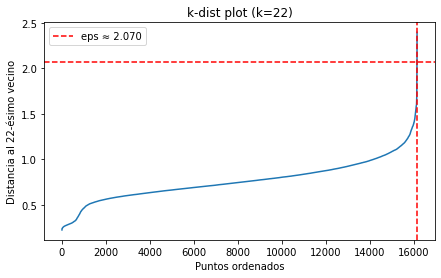

El valor óptimo de eps para min_samples = 22 según la curva k-dist es: 2.070400326546737


In [56]:
eps_optimo = kdist_plot(X_scaled, min_samples=2*d)

In [57]:
# =====================
# Clustering con DBSCAN
# =====================
# DBSCAN no requiere el número de clusters, pero depende de dos hiperparámetros:
# - eps: radio de vecindad
# - min_samples: mínimo número de puntos dentro de eps para no considerar a una muestra como aislada
    # (no perteneciente a un cluster)
#   • valores bajos de eps → muchos "outliers"
#   • valores altos de eps → pocos clusters (posible sobreagrupación)

dbscan = DBSCAN(eps=eps_optimo, min_samples=2*d)
clusters_dbscan = dbscan.fit_predict(X_scaled)

# Guardamos también en el DataFrame
X["Cluster_DBSCAN"] = clusters_dbscan

## 4.3. Comparación entre K-Means y DBSCAN

Realizamos algunas visualizaciones para comparar los resultados

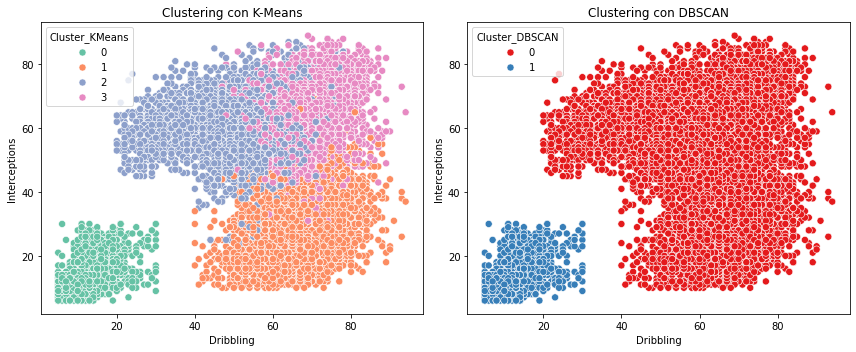

In [58]:
# ===========================
# Visualización de resultados
# ===========================
# Usamos "Dribbling" y "Interceptions" como ejes X-Y
# porque son variables fáciles de interpretar en fútbol

plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x=X["Dribbling"], y=X["Interceptions"],
                hue=X["Cluster_KMeans"], palette="Set2", s=50)
plt.title("Clustering con K-Means")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x=X["Dribbling"], y=X["Interceptions"],
                hue=X["Cluster_DBSCAN"], palette="Set1", s=50)
plt.title("Clustering con DBSCAN")

plt.tight_layout()
plt.show()

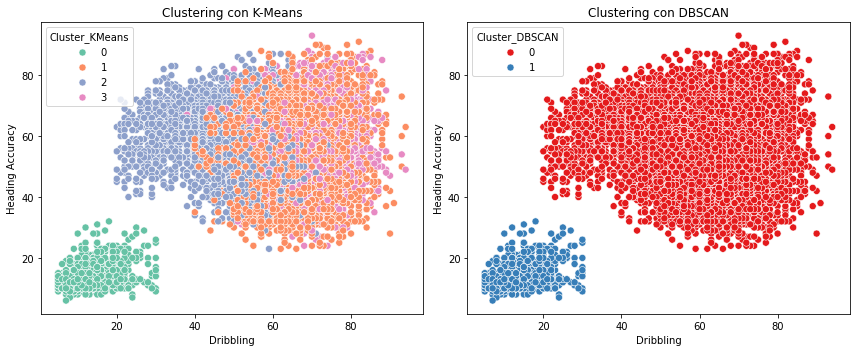

In [59]:
# Usamos "Dribbling" y "Heading Accuracy" como ejes X-Y

plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x=X["Dribbling"], y=X["Heading Accuracy"],
                hue=X["Cluster_KMeans"], palette="Set2", s=50)
plt.title("Clustering con K-Means")

# ---- DBSCAN
plt.subplot(1,2,2)

sns.scatterplot(x=X["Dribbling"], y=X["Heading Accuracy"],
                hue=X["Cluster_DBSCAN"], palette="Set1", s=50)
plt.title("Clustering con DBSCAN")

plt.tight_layout()
plt.show()

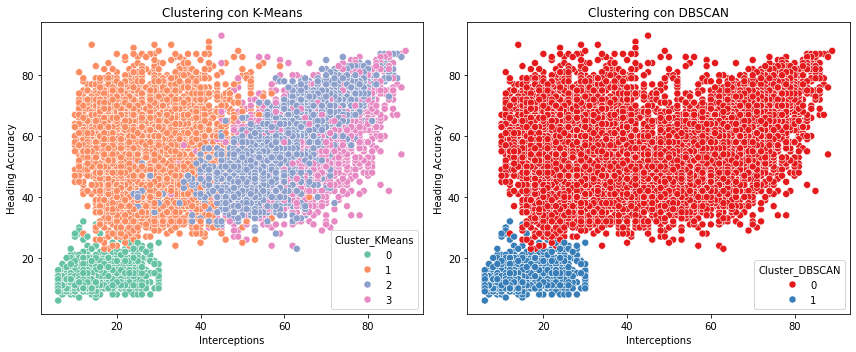

In [60]:
# Usamos "Interceptions" y "Heading Accuracy" como ejes X-Y

plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x=X["Interceptions"], y=X["Heading Accuracy"],
                hue=X["Cluster_KMeans"], palette="Set2", s=50)
plt.title("Clustering con K-Means")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x=X["Interceptions"], y=X["Heading Accuracy"],
                hue=X["Cluster_DBSCAN"], palette="Set1", s=50)
plt.title("Clustering con DBSCAN")

plt.tight_layout()
plt.show()

Veamos ejemplos concretos de jugadores en cada cluster. El primer caso es ***K-Means***.

In [61]:
# ================================================
# Ejemplos concretos de jugadores en cada cluster
# ===============================================

# Agregar nombre de los jugadores al DataFrame con clusters
df_clusters = df3.copy()
df_clusters["Cluster_KMeans"] = X["Cluster_KMeans"]
df_clusters["Cluster_DBSCAN"] = X["Cluster_DBSCAN"]

# Mostrar ejemplos de jugadores de cada cluster (KMeans)
print("\n=== Ejemplos de jugadores en cada cluster - KMeans ===\n")
for c in sorted(df_clusters["Cluster_KMeans"].unique()):
    ejemplos = df_clusters[df_clusters["Cluster_KMeans"] == c][["Name", 'Positioning', 'Finishing', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness']].head(5)
    print(f"\nCluster {c} (KMeans):")
    print(ejemplos)


=== Ejemplos de jugadores en cada cluster - KMeans ===


Cluster 0 (KMeans):
                     Name  Positioning  Finishing  Dribbling  Interceptions  \
8    Gianluigi Donnarumma           14         12         28             26   
9                 Alisson           13         13         27             11   
10       Thibaut Courtois           13         14         13             15   
13  Marc-André ter Stegen           11         14         21             22   
21                Ederson           20         14         30             27   

    Heading Accuracy  Def Awareness  
8                 12             21  
9                 29             15  
10                13             20  
13                11             25  
21                14             29  

Cluster 1 (KMeans):
                Name  Positioning  Finishing  Dribbling  Interceptions  \
0      Kylian Mbappé           93         94         93             38   
2     Erling Haaland           96         96      

Veamos ejemplos concretos de jugadores en cada cluster. El segundo caso es ***DBSCAN***.

In [62]:
# Mostrar ejemplos de jugadores de cada cluster (DBSCAN)
print("\n=== Ejemplos de jugadores en cada cluster - DBSCAN ===\n")
for c in sorted(df_clusters["Cluster_DBSCAN"].unique()):
    if c == -1:
        print("\nCluster -1: jugadores considerados *outliers* por DBSCAN")
    ejemplos = df_clusters[df_clusters["Cluster_DBSCAN"] == c][["Name", 'Positioning', 'Finishing', 'Dribbling', 'Interceptions', 'Heading Accuracy', 'Def Awareness']].head(5)
    print(f"\n🔹 Cluster {c} (DBSCAN):")
    print(ejemplos)


=== Ejemplos de jugadores en cada cluster - DBSCAN ===


🔹 Cluster 0 (DBSCAN):
              Name  Positioning  Finishing  Dribbling  Interceptions  \
0    Kylian Mbappé           93         94         93             38   
1            Rodri           76         74         84             84   
2   Erling Haaland           96         96         79             43   
3  Jude Bellingham           91         90         89             82   
4         Vini Jr.           87         89         93             26   

   Heading Accuracy  Def Awareness  
0                73             26  
1                81             92  
2                83             38  
3                75             77  
4                50             32  

🔹 Cluster 1 (DBSCAN):
                     Name  Positioning  Finishing  Dribbling  Interceptions  \
8    Gianluigi Donnarumma           14         12         28             26   
9                 Alisson           13         13         27             11   
10   

Comparación general

| Aspecto                | K-Means                                                   | DBSCAN                                                                |
| ---------------------- | --------------------------------------------------------- | --------------------------------------------------------------------- |
| Elección de parámetros | Necesita **K** (número de clusters) → elegido con el codo y silueta| Necesita `eps` y `min_samples` (Elegido con curva k-dist) |
| Forma de clusters      | Esféricos y balanceados                                   | Arbitrarias, puede detectar formas raras                              |
| Jugadores atípicos     | Siempre asignados a un cluster                            | Pueden quedar como *outliers* (`-1`)                                  |
| Interpretación         | Divide por cercanía en funcionalidaes      | Encuentra grupos más especializados y detecta jugadores distintos     |

Es importante localizar algunos jugadores elegidos para realizar una comparativa entre jugadores:


=== Comparación de jugadores elegidos ===

                     Name  Dribbling  Interceptions  Cluster_KMeans  \
0           Kylian Mbappé         93             38               1   
3         Jude Bellingham         89             82               3   
8    Gianluigi Donnarumma         28             26               0   
11       Lautaro Martínez         85             48               1   
12        Virgil van Dijk         70             88               3   
129           Kyle Walker         78             78               3   

     Cluster_DBSCAN  
0                 0  
3                 0  
8                 1  
11                0  
12                0  
129               0  


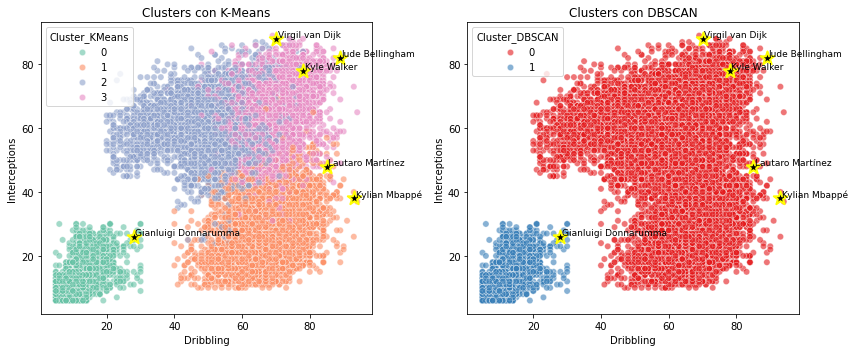

In [63]:
# ============================================
# Comparación de jugadores en K-Means y DBSCAN
# ============================================

# Lista de jugadores que queremos comparar
jugadores_top = ["Kylian Mbappé", "Jude Bellingham", "Lautaro Martínez", "Virgil van Dijk", "Gianluigi Donnarumma", "Kyle Walker"]

# Filtramos esos jugadores en el DataFrame con clusters
df_top = df_clusters[df_clusters["Name"].isin(jugadores_top)]

print("\n=== Comparación de jugadores elegidos ===\n")
print(df_top[["Name", "Dribbling", "Interceptions", "Cluster_KMeans", "Cluster_DBSCAN"]])

# ======================================================
# Visualización comparativa: Dribbling vs. Interceptions
# ======================================================

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# ---- KMeans ----
axes[0].set_title("Clusters con K-Means")
sns.scatterplot(
    x="Dribbling", y="Interceptions", 
    hue="Cluster_KMeans", 
    data=df_clusters, palette="Set2", s=40, ax=axes[0], alpha=0.6
)

# Marcamos jugadores elegidos con estrella
for _, row in df_top.iterrows():
    axes[0].scatter(row["Dribbling"], row["Interceptions"], 
                    s=200, c="black", marker="*", edgecolor="yellow", linewidth=2)
    axes[0].text(row["Dribbling"]+0.5, row["Interceptions"]+0.5, row["Name"], fontsize=9)

# ---- DBSCAN ----
axes[1].set_title("Clusters con DBSCAN")
sns.scatterplot(
    x="Dribbling", y="Interceptions", 
    hue="Cluster_DBSCAN", 
    data=df_clusters, palette="Set1", s=40, ax=axes[1], alpha=0.6
)

# Marcamos jugadores elegidos con estrella
for _, row in df_top.iterrows():
    axes[1].scatter(row["Dribbling"], row["Interceptions"], 
                    s=200, c="black", marker="*", edgecolor="yellow", linewidth=2)
    axes[1].text(row["Dribbling"]+0.5, row["Interceptions"]+0.5, row["Name"], fontsize=9)

plt.tight_layout()
plt.show()

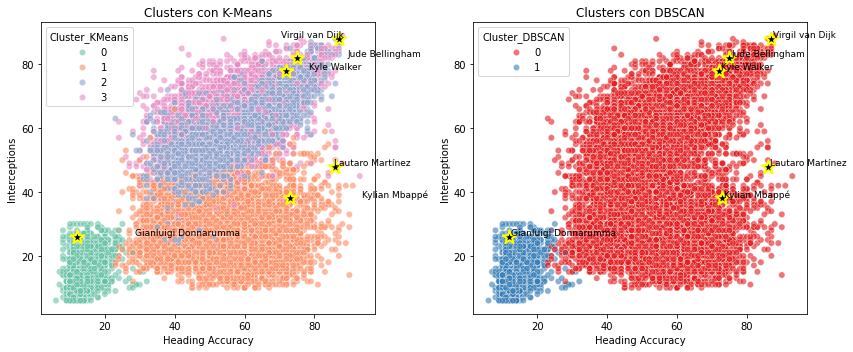

In [64]:
# ======================================================
# Visualización comparativa: Dribbling vs. Interceptions
# ======================================================

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# ---- KMeans ----
axes[0].set_title("Clusters con K-Means")
sns.scatterplot(
    x="Heading Accuracy", y="Interceptions", 
    hue="Cluster_KMeans", 
    data=df_clusters, palette="Set2", s=40, ax=axes[0], alpha=0.6
)

# Marcamos jugadores elegidos con estrella
for _, row in df_top.iterrows():
    axes[0].scatter(row["Heading Accuracy"], row["Interceptions"], 
                    s=200, c="black", marker="*", edgecolor="yellow", linewidth=2)
    axes[0].text(row["Dribbling"]+0.5, row["Interceptions"]+0.5, row["Name"], fontsize=9)

# ---- DBSCAN ----
axes[1].set_title("Clusters con DBSCAN")
sns.scatterplot(
    x="Heading Accuracy", y="Interceptions", 
    hue="Cluster_DBSCAN", 
    data=df_clusters, palette="Set1", s=40, ax=axes[1], alpha=0.6
)

# Marcamos jugadores elegidos con estrella
for _, row in df_top.iterrows():
    axes[1].scatter(row["Heading Accuracy"], row["Interceptions"], 
                    s=200, c="black", marker="*", edgecolor="yellow", linewidth=2)
    axes[1].text(row["Heading Accuracy"]+0.5, row["Interceptions"]+0.5, row["Name"], fontsize=9)

plt.tight_layout()
plt.show()

## 5. Análisis Cualitativo de los Clusters Encontrados

1. ¿Qué hay en cada cluster?

- Cada cluster representa un grupo de jugadores con características técnicas similares (ej: niveles similares de positioning, long passing, etc.).
- En `K-Means`, los clusters tienden a ser más “balanceados” en tamaño, porque el algoritmo fuerza una partición.
- En `DBSCAN`, pueden aparecer:
    - clusters pequeños → jugadores con habilidades muy específicas.
    - outliers (-1) → jugadores únicos que no encajan en ningún grupo (ej: Messi, CR7, Haaland, etc.).

2. ¿Son equivalentes los jugadores de un cluster?

- En los clusters obtenidos por k-means, vimos en las comparaciones de la [sección 4.3](#4.3.-Comparaci%C3%B3n-entre-K-Means-y-DBSCAN) que los jugadores dentro de un mismo cluster sí cumplen aproximadamente roles similares, aunque no nos da una clasificación tan fina como la que obtenemos al considerar las posiciones específicas de cada uno. k-means logra agrupar a los jugadores por habilidades similares. En el caso de los clusters obtenidos por DBSCAN, apenas logramos separar a los arqueros de los jugadores de campo, pero no logramos diferenciar a los jugadores de campo entre sí, por lo que este clustering no nos permite diferenciarlos por funcionalidad.

3. Si son heterogéneos, ¿por qué se agrupan?

- Porque los algoritmos buscan minimizar distancias globales en varias dimensiones.
- Puede pasar que:
    - Jugadores con stats intermedios (no muy altos ni bajos) caigan juntos, aunque sus estilos de juego difieran.
    - `K-Means`, en particular, puede “forzar” un cluster con jugadores diversos para que se complete el número k.
- En `DBSCAN`, jugadores “aislados” que no tienen suficientes vecinos pueden terminar como outliers o en clusters chicos. Por otro lado, las fronteras entre los clusters que uno querría esperar no son lo suficientemente pronunciadas. Dado que las posiciones de un jugador según sus habilidades es muy matizada (es decir, no tiene fronteras claras), quizás sea necesario considerar a este dataset como uno más ruidoso de lo pensado originalmente. Podría probarse en una instancia posterior con un número mayor de min_samples, a costa de tener muchos más outliers.

4. Diferencias en tamaño de los clusters

- `K-Means`: Suelen tener tamaños más equilibrados, pero no siempre reales. Ejemplo: puede dividir “mal” si un grupo real es pequeño (como los cracks mundiales).
- `DBSCAN`: tamaños más realistas entre los clusters obtenidos. El cluster correspondiente a jugadores de campo es mucho más numeroso que el de arqueros.

Para reforzar estas observaciones, veamos algunos análisis estadísticos de los clusters obtenidos:

## 5.1. Análisis estadísticos de los Clusters

Veamos algunas descripciones estadísticas de los clusters obtenidos

In [65]:
# ================================================
# Perfil estadístico: Análisis de clusters K-Means
# ================================================
print("\n============================")
print("Perfil de clusters - KMeans")
print("============================")

# Agrupamos por el cluster y calculamos estadísticas
profile_kmeans = X.groupby("Cluster_KMeans")[skills].agg(["mean", "std", "count"])
profile_kmeans


Perfil de clusters - KMeans


Positioning                   Finishing                  \
                      mean        std count       mean       std count   
Cluster_KMeans                                                           
0                 9.595815   4.239609  1816  10.369493  4.176220  1816   
1                64.459407   8.617001  4656  64.360825  8.529822  4656   
2                40.922278  11.423073  4619  32.318900  8.387245  4619   
3                62.598028   7.856611  5070  56.533136  9.077296  5070   

               Long Shots                    Volleys                   \
                     mean       std count       mean        std count   
Cluster_KMeans                                                          
0               10.869493  4.507726  1816  10.678414   4.376886  1816   
1               59.666237  9.539035  4656  56.724227  10.395197  4656   
2               33.873349  9.905890  4619  31.377354   6.801066  4619   
3               60.060355  9.314792  5070  51.222091  10.676985  5070   

                Penalties                  Dribbling                   \
                     mean       std count       mean        std count   
Cluster_KMeans                                                          
0               18.235132  6.883229  1816  13.127203   4.715815  1816   
1               59.961555  9.317829  4656  66.542526   8.016063  4656   
2               39.453345  6.744593  4619  51.113877  10.767495  4619   
3               54.235108  9.742186  5070  67.232150   6.873627  5070   

               Interceptions                 Heading Accuracy             \
                        mean       std count             mean        std   
Cluster_KMeans                                                             
0                  14.678414  5.739342  1816        13.667401   3.431270   
1                  28.729811  9.987749  4656        54.963918  13.086196   
2                  61.551418  8.152729  4619        59.128599  10.647138   
3                  63.160750  8.577752  5070        56.095266   9.990082   

                     Def Awareness                 Standing Tackle             \
               count          mean       std count            mean        std   
Cluster_KMeans                                                                  
0               1816     12.734581  5.836811  1816       13.653634   3.107543   
1               4656     30.413660  9.836049  4656       30.858892  10.141854   
2               4619     61.491665  8.848301  4619       63.891968   7.727649   
3               5070     61.362919  9.191741  5070       64.369231   7.913430   

                     Sliding Tackle                  
               count           mean       std count  
Cluster_KMeans                                       
0               1816      13.598568  3.129910  1816  
1               4656      28.353522  9.583239  4656  
2               4619      61.939597  7.560699  4619  
3               5070      61.315385  8.607377  5070

In [66]:
# ===============================================
# Perfil estadístico: Análisis de clusters DBSCAN
# ===============================================
print("\n============================")
print("Perfil de clusters - DBSCAN")
print("============================")

# Agrupamos por el cluster DBSCAN (-1 = outliers)
profile_dbscan = X.groupby("Cluster_DBSCAN")[skills].agg(["mean", "std", "count"])

profile_dbscan


Perfil de clusters - DBSCAN


Positioning                    Finishing                    \
                      mean        std  count       mean        std  count   
Cluster_DBSCAN                                                              
0                56.222726  14.131270  14345  51.276961  16.013891  14345   
1                 9.595815   4.239609   1816  10.369493   4.176220   1816   

               Long Shots                      Volleys                    \
                     mean        std  count       mean        std  count   
Cluster_DBSCAN                                                             
0               51.500383  15.471936  14345  46.618055  14.341816  14345   
1               10.869493   4.507726   1816  10.678414   4.376886   1816   

                Penalties                    Dribbling                    \
                     mean        std  count       mean        std  count   
Cluster_DBSCAN                                                             
0               51.334123  12.204504  14345  61.818334  11.374447  14345   
1               18.235132   6.883229   1816  13.127203   4.715815   1816   

               Interceptions                   Heading Accuracy             \
                        mean        std  count             mean        std   
Cluster_DBSCAN                                                               
0                  51.467201  18.129082  14345        56.704775  11.416941   
1                  14.678414   5.739342   1816        13.667401   3.431270   

                      Def Awareness                   Standing Tackle  \
                count          mean        std  count            mean   
Cluster_DBSCAN                                                          
0               14345     51.359080  17.242329  14345       53.339003   
1                1816     12.734581   5.836811   1816       13.653634   

                                 Sliding Tackle                    
                      std  count           mean        std  count  
Cluster_DBSCAN                                                     
0               17.822364  14345      50.817846  17.803842  14345  
1                3.107543   1816      13.598568   3.129910   1816

Estos valores pueden visualizarse mejor en Boxplots.

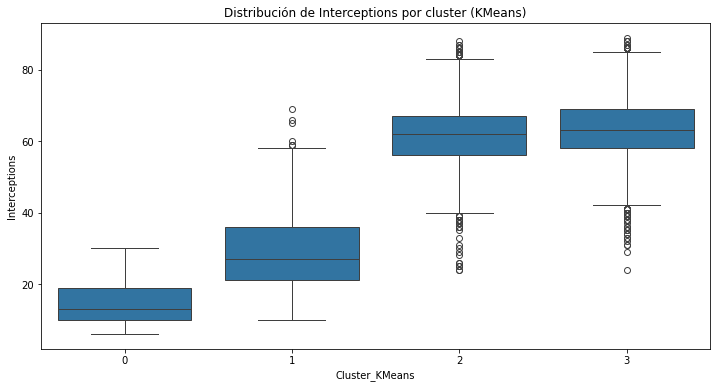

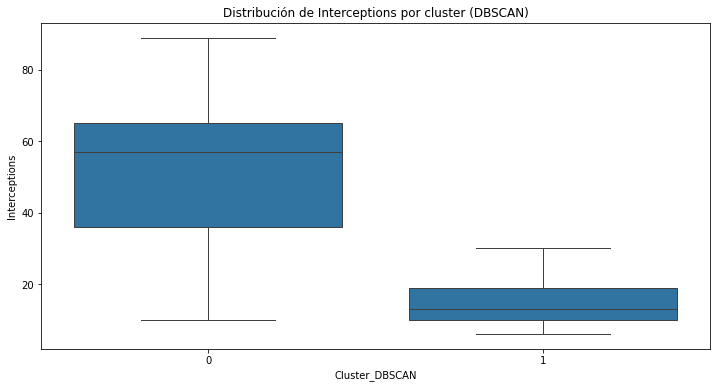

In [67]:
# ==========================
# Visualización con boxplots
# ==========================

# ---- KMeans
plt.figure(figsize=(12, 6))
sns.boxplot(data=X, x="Cluster_KMeans", y="Interceptions")
plt.title("Distribución de Interceptions por cluster (KMeans)")
plt.show()

# ---- DBSCAN
plt.figure(figsize=(12, 6))
sns.boxplot(data=X, x="Cluster_DBSCAN", y="Interceptions")
plt.title("Distribución de Interceptions por cluster (DBSCAN)")
plt.show()

Además, podemos resalizar una descripcion automática de cada cluster: 

In [68]:
# ==================================
# Descripción automática de clusters
# ==================================

# Calculamos la media global de cada habilidad (para referencia)
global_means = X[skills].mean()

def describe_cluster(profile_df, cluster_name):
    """
    Genera descripciones cualitativas de cada cluster
    a partir de sus medias comparadas con la media global.
    """
    descriptions = {}
    for cluster_id, row in profile_df.iterrows():
        desc = []
        for skill in skills:
            # comparación con media global
            if row[(skill, "mean")] > global_means[skill] + 5:
                desc.append(f"{skill} ALTO")
            elif row[(skill, "mean")] < global_means[skill] - 5:
                desc.append(f"{skill} BAJO")
            else:
                desc.append(f"{skill} MEDIO")
        
        descriptions[cluster_id] = (
            f"- {cluster_name} {cluster_id} (n={int(row[(skills[0],'count')])}) → " 
            + ", ".join(desc)
        )
    return descriptions

# ---- KMeans
print("\n================================")
print("Descripción de clusters - KMeans")
print("================================")
desc_kmeans = describe_cluster(profile_kmeans, "Cluster KMeans")
for cid, d in desc_kmeans.items():
    print(d)

# ---- DBSCAN
print("\n================================")
print("Descripción de clusters - DBSCAN")
print("================================")
desc_dbscan = describe_cluster(profile_dbscan, "Cluster DBSCAN")
for cid, d in desc_dbscan.items():
    print(d)


Descripción de clusters - KMeans
- Cluster KMeans 0 (n=1816) → Positioning BAJO, Finishing BAJO, Long Shots BAJO, Volleys BAJO, Penalties BAJO, Dribbling BAJO, Interceptions BAJO, Heading Accuracy BAJO, Def Awareness BAJO, Standing Tackle BAJO, Sliding Tackle BAJO
- Cluster KMeans 1 (n=4656) → Positioning ALTO, Finishing ALTO, Long Shots ALTO, Volleys ALTO, Penalties ALTO, Dribbling ALTO, Interceptions BAJO, Heading Accuracy MEDIO, Def Awareness BAJO, Standing Tackle BAJO, Sliding Tackle BAJO
- Cluster KMeans 2 (n=4619) → Positioning BAJO, Finishing BAJO, Long Shots BAJO, Volleys BAJO, Penalties BAJO, Dribbling BAJO, Interceptions ALTO, Heading Accuracy ALTO, Def Awareness ALTO, Standing Tackle ALTO, Sliding Tackle ALTO
- Cluster KMeans 3 (n=5070) → Positioning ALTO, Finishing ALTO, Long Shots ALTO, Volleys ALTO, Penalties ALTO, Dribbling ALTO, Interceptions ALTO, Heading Accuracy MEDIO, Def Awareness ALTO, Standing Tackle ALTO, Sliding Tackle ALTO

Descripción de clusters - DBSCAN
- 



***Conclusión***

En el análisis de `K-Means`, observamos que los clusters agrupan jugadores con características generales similares, lo cual sugiere que los integrantes de un cluster podrían cumplir roles semejantes en un equipo (por ejemplo, delanteros o defensores). Sin embargo, algunos clusters presentan cierta heterogeneidad, lo que refleja que el algoritmo no logra diferenciar roles más específicos, como pueden serlo jugadores de centro o de banda. En contraste, `DBSCAN` sólo fue capaz de diferenciar entre arqueros y jugadores de campo, no logrando cumplir el objetivo planteado. Las diferencias en tamaño entre clusters se explican porque existen muchos jugadores de campo que arqueros.

## 6. Embedding

En el análisis de datos de jugadores resulta fundamental comprender la estructura latente de los atributos de rendimiento. Dado que el conjunto de características técnicas empleadas en este estudio incluye variables como  *OVR (Overall Rating)*, *Positioning*, *Finishing*, *Dribbling*, *Interceptions*, *Heading Accuracy* y *Def Awareness*, que pertenecen a un espacio de mayor dimensión, se vuelve complejo observar patrones o agrupamientos directamente. En este contexto, el uso de técnicas de reducción de dimensionalidad como `PCA` (Análisis de Componentes Principales) y `t-SNE` (t-distributed Stochastic Neighbor Embedding) constituye una herramienta valiosa tanto para la visualización como para el preprocesado previo al clustering.

- `PCA` (Análisis de Componentes Principales) es una técnica lineal que proyecta los datos en direcciones que maximizan la varianza, lo que permite representar en un plano bidimensional las tendencias globales de variación entre los jugadores. De este modo, se facilita la detección de grupos amplios y la interpretación de qué atributos dominan en la diferenciación (por ejemplo, jugadores que destacan más por su *Dribbling* frente a quienes se distinguen por su *Passing*). Además, PCA permite cuantificar cuánta información se conserva en cada componente, lo que ayuda a evaluar la calidad de la reducción dimensional. Sin embargo, al ser una técnica lineal, puede no capturar relaciones complejas o no evidentes entre las variables.
- `t-SNE` (t-distributed Stochastic Neighbor Embedding), en cambio, es una técnica no lineal que preserva la estructura local de los datos, es decir, mantiene proximidades entre individuos que son similares en varias dimensiones. Esto la convierte en una herramienta muy útil para descubrir clusters más sutiles o subgrupos dentro de un mismo perfil de jugador, que PCA podría no distinguir. t-SNE es especialmente potente para visualizar agrupamientos complejos, aunque puede ser sensible a la elección de parámetros (como la "perplexity") y requiere mayor tiempo de cómputo. Además, los resultados pueden variar entre ejecuciones debido a su naturaleza estocástica, por lo que es recomendable realizar varias pruebas y comparar visualizaciones.

El aporte de estas técnicas al análisis de clustering es doble:

1. ***Visualización***: permiten observar en dos dimensiones cómo se organizan los jugadores, ayudando a validar de forma cualitativa los resultados de algoritmos de clustering como `K-Means` o `DBSCAN`.
2. ***Preprocesado***: en algunos casos, proyectar los datos a un espacio reducido (por ejemplo, las dos o tres primeras componentes principales de `PCA`) puede mejorar la separación de clusters y reducir el ruido en las variables originales.

En conclusión, la combinación de `PCA` y `t-SNE` enriquece el análisis porque brinda perspectivas complementarias: `PCA` aporta interpretabilidad y visión global, mientras que `t-SNE` permite revelar agrupamientos finos y relaciones locales. Así, ambas técnicas facilitan una comprensión más profunda de la estructura de los jugadores y del sentido de los clusters encontrados.

### 6.1. PCA (Principal Component Analysis)

Primero, realicemos un análisis de `PCA`.

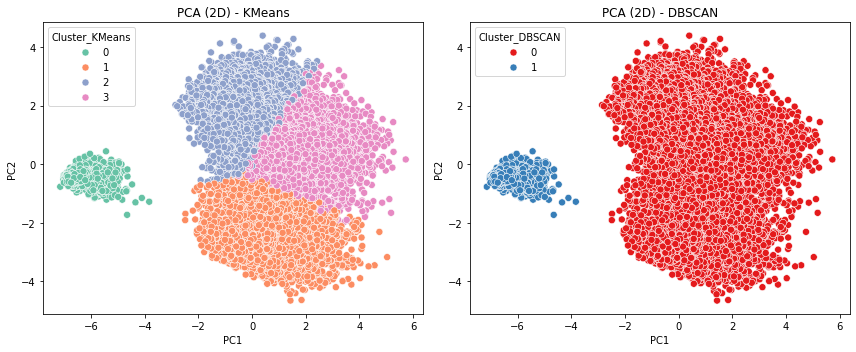

In [69]:
# ===============================
# Reducir dimensionalidad con PCA
# ===============================
pca = PCA(n_components=2)  # proyectamos a 2 dimensiones
X_pca = pca.fit_transform(X_scaled)

# Guardamos en DataFrame para graficar
df_pca = pd.DataFrame(X_pca, columns=["PC1", "PC2"])
df_pca["Cluster_KMeans"] = X["Cluster_KMeans"]
df_pca["Cluster_DBSCAN"] = X["Cluster_DBSCAN"]

# ===================
# Visualización en 2D
# ===================
plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_KMeans",
                palette="Set2", data=df_pca, s=50)
plt.title("PCA (2D) - KMeans")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_pca, s=50)
plt.title("PCA (2D) - DBSCAN")

plt.tight_layout()
plt.show()

En la anterior figura podemos visualizar regiones bien definidas, sugiriendo una clara clasificación. Veamos ahora dos casos de interés:
- Ubicación de jugadores escogidos: *Mbappé*, *Bellingham*, *Lautaro*, *Van Dijk*, *Donnarumma* y *Walker*.
- Comparación con respecto si los jugadores pertenecen a la clasificación ***Forward***, ***Midfielder***, ***Defender***, ***GK***.

Veamos primero a los jugadores seleccionados:

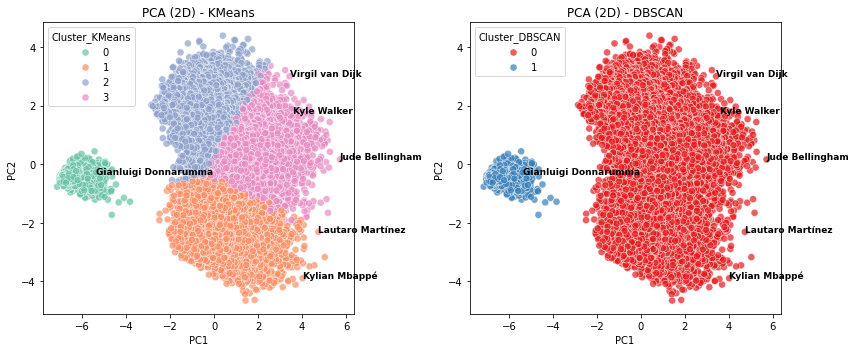

In [70]:
# ===============================
# Reducir dimensionalidad con PCA
# ===============================

# Guardamos en DataFrame para graficar
df_pca["Name"] = df["Name"]  # agregamos los nombres de los jugadores
df_pca["Position"] = df["Position"]  # posiciones originales

# =======================================================
# Visualización en 2D con etiquetas de jugadores elegidos
# =======================================================
plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_KMeans",
                palette="Set2", data=df_pca, s=50, alpha=0.7)
plt.title("PCA (2D) - KMeans")

# Etiquetamos jugadores elegidos
for player in jugadores_top:
    # buscamos el jugador en df_pca
    subset = df_pca[df_pca["Name"] == player]
    if not subset.empty:
        x, y = subset["PC1"].values[0], subset["PC2"].values[0]
        plt.text(x, y, player, fontsize=9, fontweight="bold", color="black")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_pca, s=50, alpha=0.7)
plt.title("PCA (2D) - DBSCAN")

# Etiquetamos jugadores top
for player in jugadores_top:
    subset = df_pca[df_pca["Name"] == player]
    if not subset.empty:
        x, y = subset["PC1"].values[0], subset["PC2"].values[0]
        plt.text(x, y, player, fontsize=9, fontweight="bold", color="black")

plt.tight_layout()
plt.show()

Ahora, podemos analizar según la posición general en la que juegan:

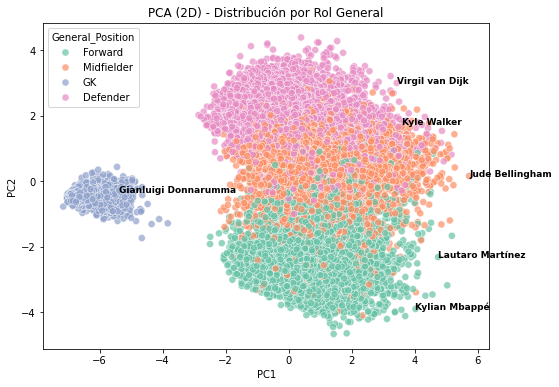

In [71]:
# =====================================================================
# Clasificación por roles generales (Forward, Midfielder, Defender, GK)
# =====================================================================

# === Creo una nueva columna con las posiciones generales ===
df_pca["General_Position"] = df_pca["Position"].apply(lambda x: GeneralPosition(x))

# =================================
# Visualización PCA por rol general
# =================================
plt.figure(figsize=(8,6))
sns.scatterplot(x="PC1", y="PC2", hue="General_Position",
                palette="Set2", data=df_pca, s=50, alpha=0.7)
plt.title("PCA (2D) - Distribución por Rol General")

# Etiquetamos jugadores top nuevamente
for player in jugadores_top:
    subset = df_pca[df_pca["Name"] == player]
    if not subset.empty:
        x, y = subset["PC1"].values[0], subset["PC2"].values[0]
        plt.text(x, y, player, fontsize=9, fontweight="bold", color="black")

# Imprimo el grafico
plt.show()

**Interpretación del análisis con PCA**

La reducción de dimensionalidad mediante `PCA` (*Análisis de Componentes Principales*) permite proyectar la información de múltiples atributos de los jugadores en un plano 2D. Esta representación facilita la visualización y comparación de patrones, ya que condensa la variabilidad más relevante de los datos en dos componentes principales.

En primer lugar, al graficar los resultados de `KMeans` y `DBSCAN`, observamos cómo los jugadores se agrupan en el espacio reducido según características estadísticas similares. Al destacar a los jugadores top (Mbappé, Bellingham, Lautaro, Van Dijk, Donnarumma y Walker), se aprecia que estos se ubican en regiones diferenciadas que corresponden a su rol dentro del campo:

- *Mbappé* y *Lautaro Martínez* aparecen cercanos en el espacio de atacantes, lo que refleja su perfil de ***forwards*** con alta influencia ofensiva.

- *Bellingham*, en cambio, se posiciona más hacia la zona intermedia, coherente con su rol de ***mediocampista versátil***.

- *Van Dijk* y *Walker* se agrupan dentro de la región de ***defensores***, destacando perfiles más físicos y tácticos.

- *Donnarumma* aparece claramente separado en la región asociada a los ***arqueros***, validando la capacidad de `PCA` para distinguir este rol específico.

En segundo lugar, al colorear los puntos según la ***clasificación de roles generales*** (***Forward***, ***Midfielder***, ***Defender***, ***GK***), se confirma que las posiciones futbolísticas tradicionales se reflejan en la estructura matemática de los datos. Los atacantes se agrupan en un extremo, los mediocampistas en el centro, los defensores en otra región y los arqueros ocupan una zona bien aislada.

En síntesis, el análisis mediante PCA permite ***validar la coherencia de los clusters*** obtenidos previamente y aporta una representación clara de cómo las distintas posiciones y estilos de juego se distribuyen en el espacio de atributos. Además, al resaltar jugadores de élite, se observa que estos encajan dentro de los patrones globales, pero se ubican en regiones más “extremas”, lo cual refleja su nivel sobresaliente en determinadas características.

### 6.2  t-SNE (t-distributed Stochastic Neighbor Embedding)

Luego, implementamos `t-SNE`, donde debemos tener en cuenta que:

- `perplexity` → controla el “balance” entre estructura local y global (suele usarse 5–50).
- `max_iter` → número máximo de iteraciones de optimización.
- `random_state` → asegura reproducibilidad.

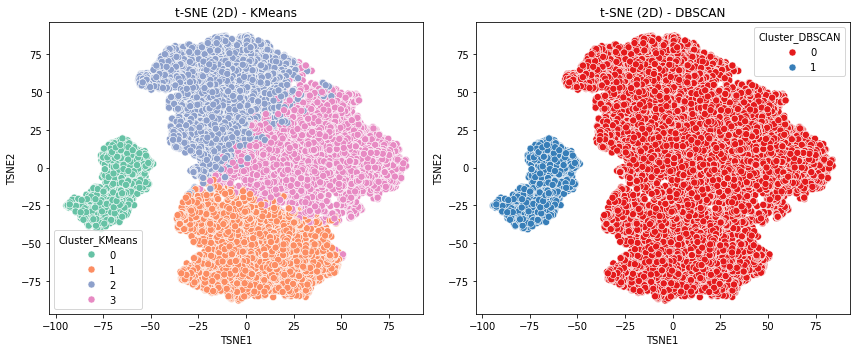

In [72]:
# ====================
# Proyección con t-SNE
# ====================
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
X_tsne = tsne.fit_transform(X_scaled)

df_tsne = pd.DataFrame(X_tsne, columns=["TSNE1", "TSNE2"])
df_tsne["Cluster_KMeans"] = X["Cluster_KMeans"]
df_tsne["Cluster_DBSCAN"] = X["Cluster_DBSCAN"]

# =============
# Visualización
# =============
plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_KMeans",
                palette="Set2", data=df_tsne, s=50)
plt.title("t-SNE (2D) - KMeans")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_tsne, s=50)
plt.title("t-SNE (2D) - DBSCAN")

plt.tight_layout()
plt.show()

Tal como en el caso anterior, en la anterior figura podemos visualizar regiones bien definidas, sugiriendo una clara clasificación. Nuevamente analizaremos:
- Ubicación de jugadores escogidos: *Mbappé*, *Bellingham*, *Lautaro*, *Van Dijk*, *Donnarumma* y *Walker*.
- Comparación con respecto si los jugadores pertenecen a la clasificación ***Forward***, ***Midfielder***, ***Defender***, ***GK***.

Veamos primero a los jugadores seleccionados:

/tmp/ipykernel_6781/2409416091.py:10: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



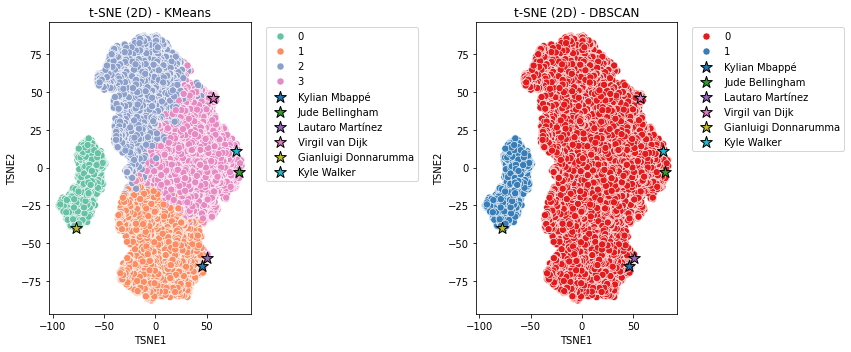

In [73]:
# ==============================
# 1. Proyección con t-SNE
# ==============================

# Guardamos en DataFrame
df_tsne["Name"] = df3["Name"]                  # nombre jugador
df_tsne["General_Position"] = df3["General_Position"]  # rol general

# Colores únicos para las estrellas (usar un colormap)
colormap = cm.get_cmap("tab10", len(jugadores_top))  # paleta de 10 colores
colores_top = {jugador: colormap(i) for i, jugador in enumerate(jugadores_top)}

# ==========================
# Visualización con clusters
# ==========================

plt.figure(figsize=(12,5))

# ---- KMeans
plt.subplot(1,2,1)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_KMeans",
                palette="Set2", data=df_tsne, s=50)
plt.title("t-SNE (2D) - KMeans")

# ---- Destacar jugadores top con estrellas de distintos colores
for jugador in jugadores_top:
    sub = df_tsne[df_tsne["Name"] == jugador]
    plt.scatter(sub["TSNE1"], sub["TSNE2"], 
                color=colores_top[jugador], s=150, marker="*", edgecolor="black", label=jugador)

plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")

# ---- DBSCAN
plt.subplot(1,2,2)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_tsne, s=50)
plt.title("t-SNE (2D) - DBSCAN")

for jugador in jugadores_top:
    sub = df_tsne[df_tsne["Name"] == jugador]
    plt.scatter(sub["TSNE1"], sub["TSNE2"], 
                color=colores_top[jugador], s=150, marker="*", edgecolor="black", label=jugador)

plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")

# Grafico
plt.tight_layout()
plt.show()

Luego, tal como en el caso anterior, analizamos según la posición general en la que juegan:

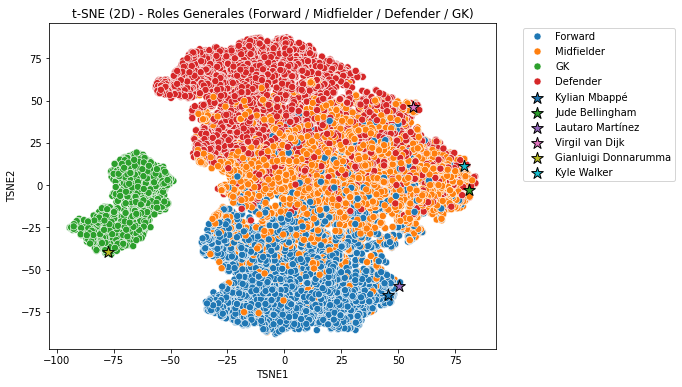

In [74]:
# =============================
# Visualización por rol general
# =============================
plt.figure(figsize=(8,6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue="General_Position",
                palette="tab10", data=df_tsne, s=50)
plt.title("t-SNE (2D) - Roles Generales (Forward / Midfielder / Defender / GK)")

# Destacar jugadores top con estrellas de distintos colores
for jugador in jugadores_top:
    sub = df_tsne[df_tsne["Name"] == jugador]
    plt.scatter(sub["TSNE1"], sub["TSNE2"], 
                color=colores_top[jugador], s=150, marker="*", edgecolor="black", label=jugador)

# Grafico
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.show()

**Interpretación del análisis con t-SNE**

El método `t-SNE` (t-distributed Stochastic Neighbor Embedding) permite proyectar los datos de alta dimensión en un espacio bidimensional, manteniendo la proximidad local entre jugadores con características similares. A diferencia de `PCA`, que busca maximizar la varianza global, `t-SNE` se centra en preservar relaciones de vecindad y, por lo tanto, es especialmente útil para revelar la existencia de agrupamientos no lineales.

En los resultados obtenidos:

1. ***Clusters*** (`KMeans` y `DBSCAN`):
    - En la proyección con `t-SNE`, los clusters definidos por `KMeans` y `DBSCAN` se distribuyen en regiones más compactas y bien separadas visualmente, lo que sugiere que el algoritmo captura similitudes entre jugadores de forma coherente con la estructura del espacio reducido.
    - El hecho de que algunos jugadores se ubiquen en los bordes entre clusters refleja que sus atributos pueden compartir características de más de un grupo.
2. ***Jugadores top*** (ej. *Mbappé*, *Bellingham*, *Lautaro*, *Van Dijk*, *Donnarumma*, *Walker*):
    - Los jugadores top aparecen como puntos destacados dentro de las zonas de `t-SNE`. Su ubicación permite comparar en qué clusters se integran y qué jugadores se agrupan cerca de ellos.
    - Por ejemplo, delanteros como Mbappé y Lautaro tienden a situarse en regiones con otros forwards de alto rendimiento, mientras que Donnarumma (arquero) y Van Dijk (defensor) aparecen en áreas más alejadas, correspondientes a sus roles específicos.
3. ***Clasificación por roles generales*** (Forwards, Midfielders, Defenders, GK):
    - La representación con `t-SNE` revela una separación natural de los roles: delanteros y mediocampistas suelen agruparse en zonas más densas, mientras que defensores y arqueros forman regiones más diferenciadas.
    - Esto confirma que los atributos físicos, técnicos y tácticos capturados en los datos contienen suficiente información para diferenciar posiciones generales, incluso sin usar explícitamente esa variable en el clustering.

En conclusión, el uso de `t-SNE` complementa al `PCA` al ofrecer una visión más clara y no lineal de las similitudes entre jugadores. Esta proyección facilita la interpretación de los clusters, la identificación de jugadores top dentro de cada grupo y la validación del agrupamiento por roles generales, lo que fortalece el análisis exploratorio del dataset.

### 6.3 Comparativa entre PCS y t-SNE

| Aspecto                            | PCA                                                                                                                          | t-SNE                                                                                                                                      |
| ---------------------------------- | ---------------------------------------------------------------------------------------------------------------------------- | ------------------------------------------------------------------------------------------------------------------------------------------ |
| **Objetivo principal**             | Maximizar la varianza global de los datos en los ejes proyectados.                                                           | Preservar las **relaciones locales** (vecindad) entre puntos.                                                                              |
| **Tipo de proyección**             | Lineal: combina atributos originales en componentes principales.                                                             | No lineal: reconstruye distancias de probabilidad entre puntos.                                                                            |
| **Interpretabilidad**              | Alta: cada componente (PC1, PC2) es combinación lineal de variables originales, permite interpretar qué atributos pesan más. | Baja: los ejes (t-SNE1, t-SNE2) no tienen significado físico directo, solo representan relaciones de similitud.                            |
| **Visualización de clusters**      | Buena para patrones globales, aunque puede "aplanar" estructuras no lineales.                                                | Excelente para **separar agrupamientos no lineales**, genera clusters más compactos y claros.                                              |
| **Ubicación de jugadores top**     | Permite ver si jugadores destacados (ej. Mbappé, Bellingham, Donnarumma) caen en zonas con perfiles similares.               | Muestra de manera más evidente los "vecinos" más cercanos de jugadores top, resaltando similitudes locales.                                |
| **Separación por roles generales** | Diferenciación parcial: algunos roles (ej. forwards vs. defensores) se distinguen, pero puede haber solapamientos.           | Diferenciación más marcada: arqueros y defensores aparecen más aislados, mientras que forwards/mediocampistas se agrupan más naturalmente. |
| **Uso en preprocesamiento**        | Útil para reducir dimensionalidad antes de aplicar clustering (reduce ruido y redundancia).                                  | Más orientado a **visualización exploratoria**; menos recomendable como input directo de clustering.                                       |

***Conclusión comparativa***

- `PCA` es más útil cuando se busca interpretar qué atributos explican las diferencias entre jugadores y como paso previo a clustering, porque simplifica el espacio de atributos sin perder interpretabilidad.
- `t-SNE` aporta un valor agregado en la visualización de similitudes locales y clusters no lineales, siendo ideal para explorar y comunicar gráficamente cómo se agrupan los jugadores.
- En conjunto, ambas técnicas son complementarias: `PCA` ayuda a explicar y `t-SNE` a visualizar.


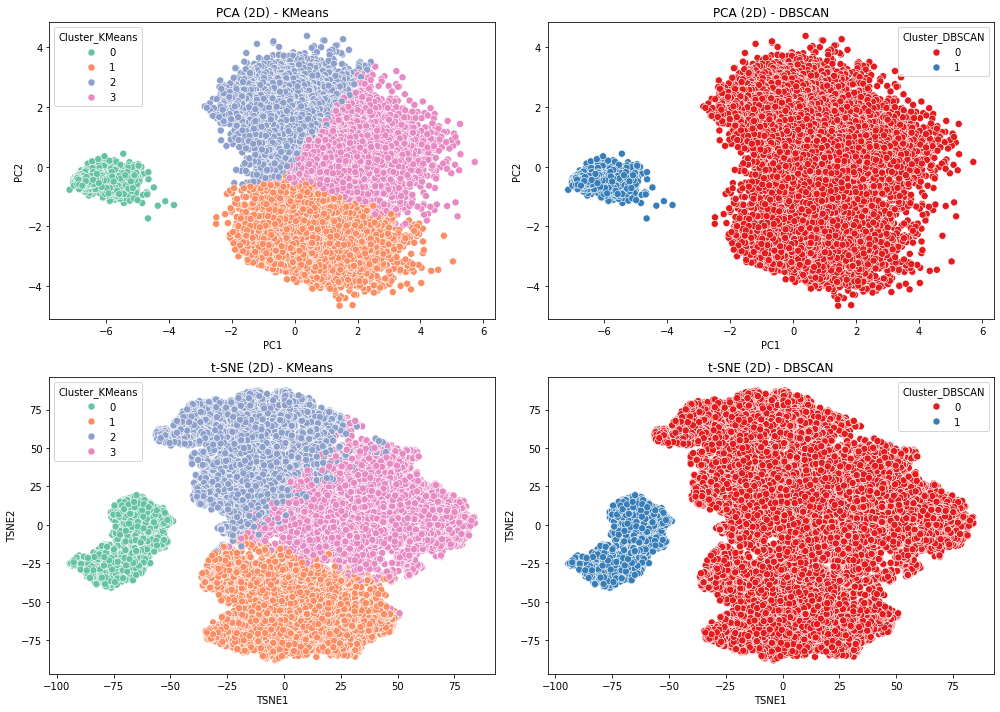

In [75]:
# ========================
# Comparación PCA vs t-SNE
# ========================

plt.figure(figsize=(14,10))

# ---- PCA (KMeans)
plt.subplot(2,2,1)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_KMeans",
                palette="Set2", data=df_pca, s=50)
plt.title("PCA (2D) - KMeans")

# ---- PCA (DBSCAN)
plt.subplot(2,2,2)
sns.scatterplot(x="PC1", y="PC2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_pca, s=50)
plt.title("PCA (2D) - DBSCAN")

# ---- t-SNE (KMeans)
plt.subplot(2,2,3)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_KMeans",
                palette="Set2", data=df_tsne, s=50)
plt.title("t-SNE (2D) - KMeans")

# ---- t-SNE (DBSCAN)
plt.subplot(2,2,4)
sns.scatterplot(x="TSNE1", y="TSNE2", hue="Cluster_DBSCAN",
                palette="Set1", data=df_tsne, s=50)
plt.title("t-SNE (2D) - DBSCAN")

plt.tight_layout()
plt.show()

## 7. Conclusiones Generales

En resumen, este trabajo muestra cómo el análisis de datos y el uso de técnicas como la reducción de dimensionalidad y el clustering ayudan a entender mejor las características y diferencias entre los jugadores. A partir de la exploración y visualización de los datos, fue posible identificar grupos y perfiles de los mismos. Estas herramientas facilitan la comparación y selección de ellos, y pueden ser útiles para tomar decisiones en la gestión de equipos. El enfoque utilizado es flexible y puede adaptarse a otros conjuntos de datos o necesidades futuras.